# <center>Data Analysis for Major Equity Indices, Currency Pairs, and Interest Rates<center>

<div style="text-align: right;">
    <h2>Stephen Sam</h2>
</div>

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance as yf
from scipy.stats import norm

## <span style="color:blue"><center>Major Financial Assets</span><center>

## <span style="color:blue"><center>1. Correlation Between Main Equity Assets (10 pts)</span><center>

### Data Preparation

In [16]:
# Define the tickers
symbols = ['^GSPC', '^STOXX50E', '^FTSE', '^SSMI']

# Set time range
start_date = '2013-11-30'
end_date = '2023-12-01'

# Initialize empty dataframe
Indices = pd.DataFrame()

# use yfinance to grab data
for symbol in symbols:
    data = yf.download(symbol, start=start_date, end=end_date)
    Indices[symbol] = data['Adj Close']

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [17]:
Indices = Indices.dropna()
Indices

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2013-12-02,1800.900024,3077.229980,6595.299805,8257.320312
2013-12-03,1795.150024,3013.879883,6532.399902,8109.890137
2013-12-04,1792.810059,2991.760010,6510.000000,8045.540039
2013-12-05,1785.030029,2953.169922,6498.299805,8025.589844
2013-12-06,1805.089966,2979.939941,6552.000000,8066.069824
...,...,...,...,...
2023-11-24,4559.339844,4372.100098,7488.200195,10879.519531
2023-11-27,4550.430176,4354.410156,7460.700195,10821.059570
2023-11-28,4554.890137,4348.020020,7455.200195,10760.379883


### <span style="color:blue">(a) Compute the correlations between main equity indices using 1M, 3M, 6M and 1Y of data.</span>

### 1M

In [314]:
_1M = 21

In [315]:
Indices_1M_corr = Indices.rolling(window = _1M).corr(pairwise=True)
Indices_1M_corr = Indices_1M_corr.dropna()
Indices_1M_corr

^GSPC  ^STOXX50E     ^FTSE     ^SSMI
Date                                                         
2014-01-07 ^GSPC      1.000000   0.906001  0.938892  0.795013
           ^STOXX50E  0.906001   1.000000  0.945474  0.900102
           ^FTSE      0.938892   0.945474  1.000000  0.879842
           ^SSMI      0.795013   0.900102  0.879842  1.000000
2014-01-08 ^GSPC      1.000000   0.952519  0.947128  0.862323
...                        ...        ...       ...       ...
2023-11-29 ^SSMI      0.923453   0.951828  0.819004  1.000000
2023-11-30 ^GSPC      1.000000   0.966860  0.667402  0.901700
           ^STOXX50E  0.966860   1.000000  0.734583  0.943901
           ^FTSE      0.667402   0.734583  1.000000  0.732974
           ^SSMI      0.901700   0.943901  0.732974  1.000000

[9568 rows x 4 columns]

### 3M

In [316]:
_3M = 21*3

In [317]:
Indices_3M_corr = Indices.rolling(window = _3M).corr(pairwise=True)
Indices_3M_corr = Indices_3M_corr.dropna()
Indices_3M_corr

^GSPC  ^STOXX50E     ^FTSE     ^SSMI
Date                                                         
2014-03-10 ^GSPC      1.000000   0.851127  0.863822  0.736363
           ^STOXX50E  0.851127   1.000000  0.959292  0.929408
           ^FTSE      0.863822   0.959292  1.000000  0.874955
           ^SSMI      0.736363   0.929408  0.874955  1.000000
2014-03-11 ^GSPC      1.000000   0.848949  0.852212  0.736708
...                        ...        ...       ...       ...
2023-11-29 ^SSMI      0.531439   0.559060  0.770016  1.000000
2023-11-30 ^GSPC      1.000000   0.953822  0.198588  0.516073
           ^STOXX50E  0.953822   1.000000  0.251072  0.541758
           ^FTSE      0.198588   0.251072  1.000000  0.794794
           ^SSMI      0.516073   0.541758  0.794794  1.000000

[9400 rows x 4 columns]

### 6M

In [318]:
_6M = 21*6

In [319]:
Indices_6M_corr = Indices.rolling(window = _6M).corr(pairwise=True)
Indices_6M_corr = Indices_6M_corr.dropna()
Indices_6M_corr

^GSPC  ^STOXX50E     ^FTSE     ^SSMI
Date                                                         
2014-06-16 ^GSPC      1.000000   0.898971  0.705597  0.827884
           ^STOXX50E  0.898971   1.000000  0.796142  0.927977
           ^FTSE      0.705597   0.796142  1.000000  0.840878
           ^SSMI      0.827884   0.927977  0.840878  1.000000
2014-06-17 ^GSPC      1.000000   0.902551  0.701187  0.831047
...                        ...        ...       ...       ...
2023-11-29 ^SSMI      0.343118   0.733647  0.569290  1.000000
2023-11-30 ^GSPC      1.000000   0.790126  0.201174  0.357980
           ^STOXX50E  0.790126   1.000000  0.336791  0.726519
           ^FTSE      0.201174   0.336791  1.000000  0.571380
           ^SSMI      0.357980   0.726519  0.571380  1.000000

[9148 rows x 4 columns]

### 1Y

In [320]:
_1Y = 21*12

In [321]:
Indices_1Y_corr = Indices.rolling(window = _1Y).corr(pairwise=True)
Indices_1Y_corr = Indices_1Y_corr.dropna()
Indices_1Y_corr

^GSPC  ^STOXX50E     ^FTSE     ^SSMI
Date                                                         
2014-12-16 ^GSPC      1.000000   0.480859  0.182149  0.876896
           ^STOXX50E  0.480859   1.000000  0.768872  0.656534
           ^FTSE      0.182149   0.768872  1.000000  0.336008
           ^SSMI      0.876896   0.656534  0.336008  1.000000
2014-12-17 ^GSPC      1.000000   0.473720  0.167081  0.877020
...                        ...        ...       ...       ...
2023-11-29 ^SSMI     -0.065888   0.437589  0.662261  1.000000
2023-11-30 ^GSPC      1.000000   0.632966 -0.307746 -0.073179
           ^STOXX50E  0.632966   1.000000  0.327082  0.432338
           ^FTSE     -0.307746   0.327082  1.000000  0.663020
           ^SSMI     -0.073179   0.432338  0.663020  1.000000

[8644 rows x 4 columns]

### <span style="color:blue">(b) Display time series of these correlations to show how stable is the data.</span>

In [324]:
def IndicesPlot(cor, tenor):
    %matplotlib inline
    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 8)) #, sharex=True, sharey=True

    k = 0

    for i in range(3):
        for j in range(i+1,4):

            ax = axes[k//3,k%3]
            ax.set_title("{} and {}".format(symbols[i], symbols[j]), fontsize = 15)
            ax.set_xlabel("Date", fontsize = 15)
            ax.set_ylabel("Correlation", fontsize = 15)
            y = cor.loc[(slice(None), symbols[i]), symbols[j]]
            y.index = y.index.get_level_values(0)
            ax.plot(y)
            ax.grid(True)
            k += 1

    fig.suptitle("Correlation Plots of %s" %tenor, fontsize=30)

    plt.tight_layout()
    plt.show()

### 1M

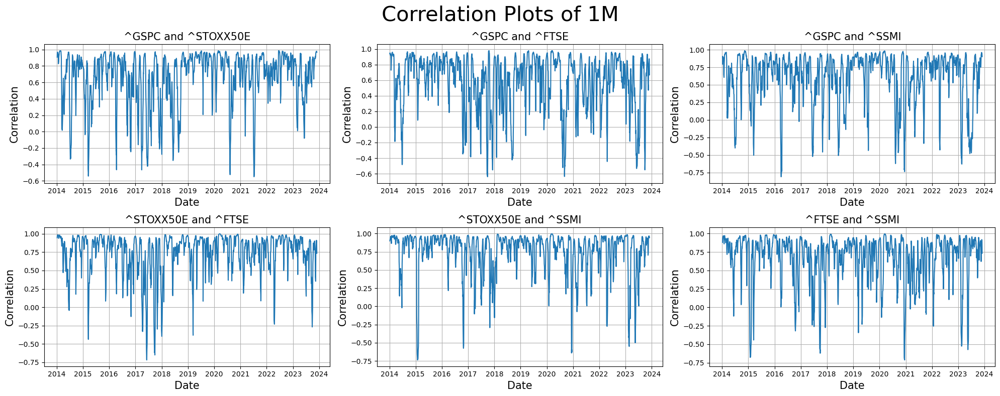

In [325]:
IndicesPlot(Indices_1M_corr,'1M')

### 3M

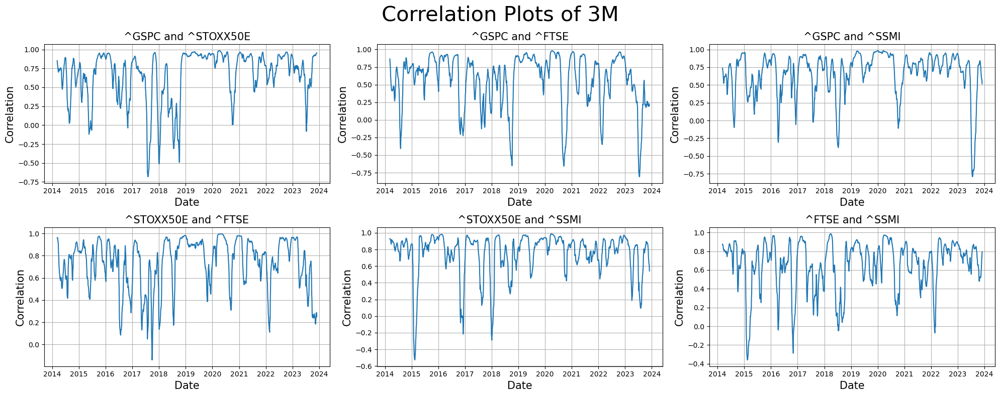

In [329]:
IndicesPlot(Indices_3M_corr,'3M')

### 6M

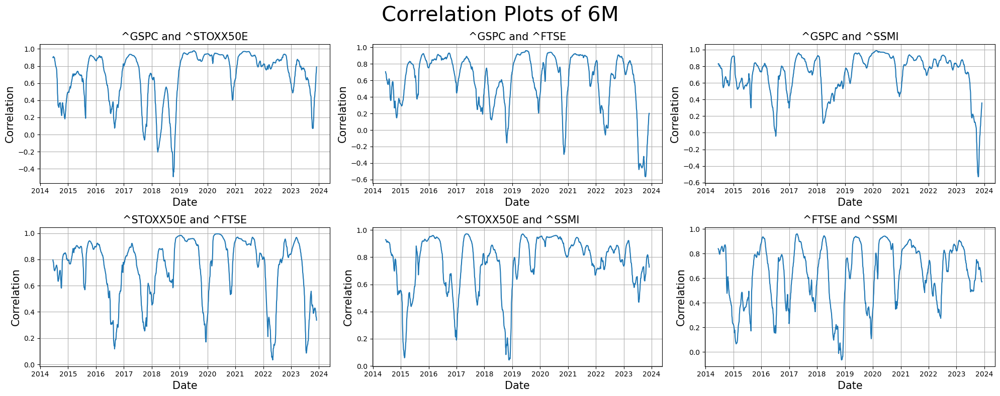

In [330]:
IndicesPlot(Indices_6M_corr,'6M')

### 1Y

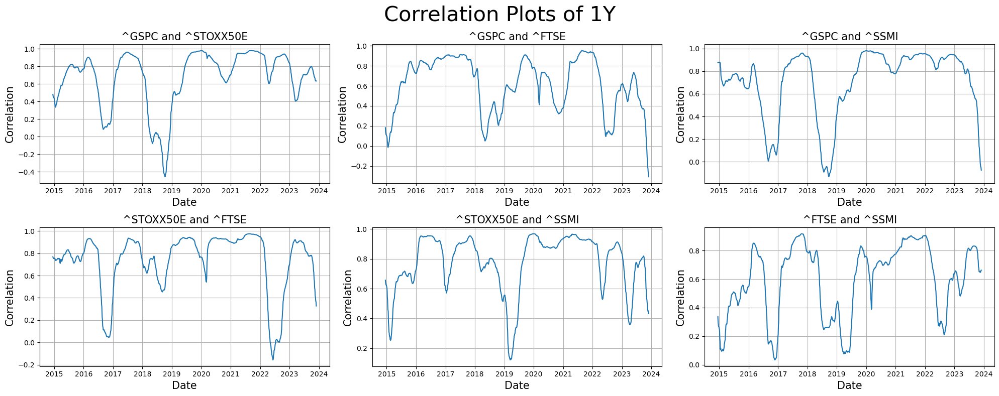

In [331]:
IndicesPlot(Indices_1Y_corr,'1Y')

### <span style="color:blue">(c) What do you conclude?</span>

__Conclusions__:

__1) The correlation time series is changing, which shows that indices are not stationary.__

__2) When the window size becomes larger (1M -> 3M -> 6M -> 1Y), the correlation changes less dramatically, which shows that indices become more stationary. And the values tend to be more positve, with range to be less.__

## <span style="color:blue"><center>2. Correlation Between Assets in Main Asset Classes (10 pts)</span><center>

### <span style="color:blue">(a) Repeat the previous question for main currency pairs and Interest Rates.</span>

## Main Currency Pairs

In [18]:
# Define main currency pairs
currency_pairs = ['USDEUR=X', 'USDGBP=X', 'USDJPY=X', 'USDCAD=X', 'USDCHF=X']

# Define time range
start_date = '2013-11-30'
end_date = '2023-12-01'

MCP = yf.download(currency_pairs, start=start_date, end=end_date)['Adj Close']

[*********************100%%**********************]  5 of 5 completed


In [19]:
MCP = MCP.dropna()
MCP

,USDCAD=X,USDCHF=X,USDEUR=X,USDGBP=X,USDJPY=X
Date,,,,,
2013-12-02,1.06219,0.90638,0.73610,0.610580,102.471001
2013-12-03,1.06420,0.90867,0.73844,0.611250,102.932999
2013-12-04,1.06390,0.90420,0.73580,0.610170,102.350998
2013-12-05,1.06765,0.90242,0.73603,0.610570,102.403999
2013-12-06,1.06470,0.89660,0.73153,0.612220,101.741997
...,...,...,...,...,...
2023-11-24,1.36950,0.88447,0.91690,0.797860,149.634995
2023-11-27,1.36305,0.88225,0.91404,0.793630,149.570999
2023-11-28,1.36070,0.88000,0.91254,0.791490,148.451996


In [199]:
def MCPPlot(cor, tenor):
    %matplotlib inline
    fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 15)) #, sharex=True, sharey=True

    k = 0

    for i in range(4):
        for j in range(i+1,5):

            ax = axes[k//2,k%2]
            ax.set_title("{} and {}".format(currency_pairs[i], currency_pairs[j]), fontsize = 15)
            ax.set_xlabel("Date", fontsize = 15)
            ax.set_ylabel("Correlation", fontsize = 15)
            y = cor.loc[(slice(None), currency_pairs[i]), currency_pairs[j]]
            y.index = y.index.get_level_values(0)
            ax.plot(y,color = 'orange')
            ax.grid(True)
            k += 1

    fig.suptitle("Correlation Plots of %s" %tenor, fontsize=25)

    plt.tight_layout()
    plt.show()

## 1M

In [172]:
MCP_1M_corr = MCP.rolling(window = _1M).corr(pairwise=True)
MCP_1M_corr = MCP_1M_corr.dropna()
MCP_1M_corr

USDCAD=X  USDCHF=X  USDEUR=X  USDGBP=X  USDJPY=X
Date                                                                 
2013-12-30 USDCAD=X  1.000000  0.355842  0.332693 -0.445165  0.427272
           USDCHF=X  0.355842  1.000000  0.984462 -0.129500 -0.109826
           USDEUR=X  0.332693  0.984462  1.000000 -0.033135 -0.181749
           USDGBP=X -0.445165 -0.129500 -0.033135  1.000000 -0.330744
           USDJPY=X  0.427272 -0.109826 -0.181749 -0.330744  1.000000
...                       ...       ...       ...       ...       ...
2023-11-30 USDCAD=X  1.000000  0.814729  0.796641  0.894588  0.799116
           USDCHF=X  0.814729  1.000000  0.981006  0.971989  0.769787
           USDEUR=X  0.796641  0.981006  1.000000  0.964911  0.727766
           USDGBP=X  0.894588  0.971989  0.964911  1.000000  0.825536
           USDJPY=X  0.799116  0.769787  0.727766  0.825536  1.000000

[12930 rows x 5 columns]

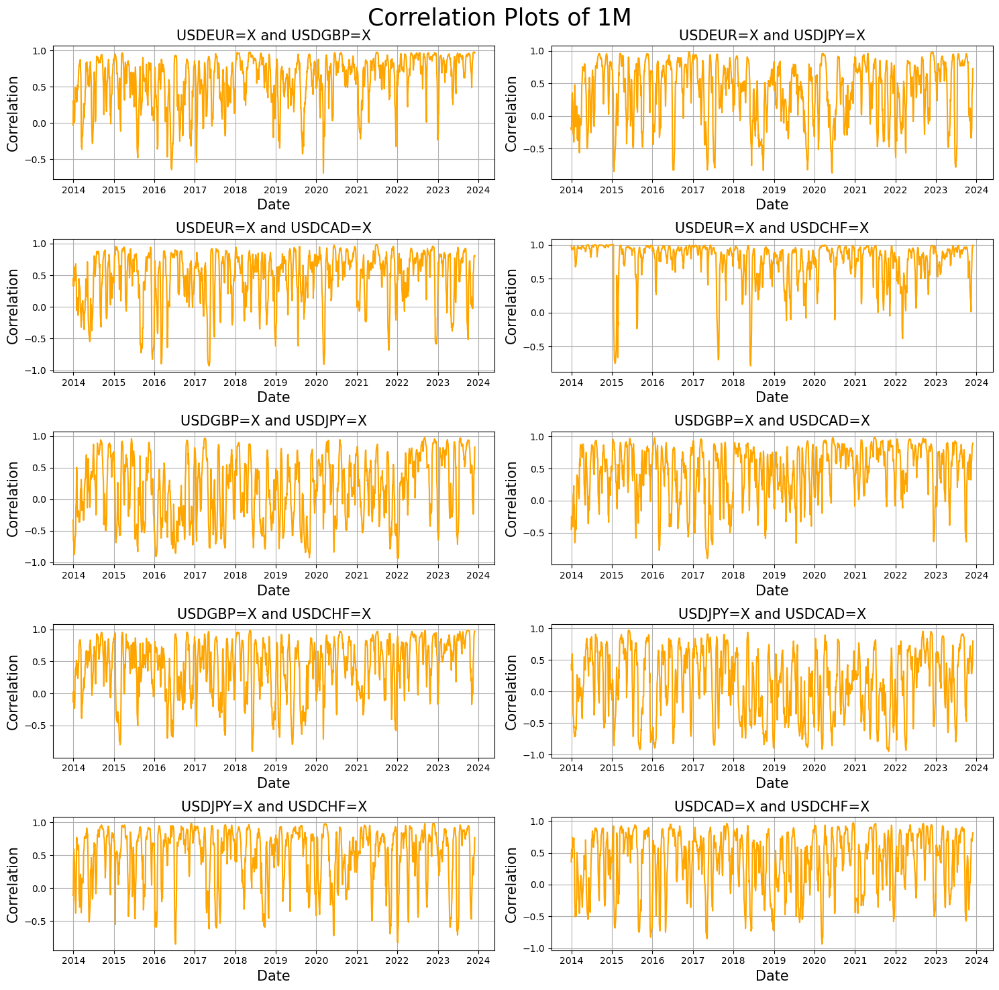

In [200]:
MCPPlot(MCP_1M_corr,'1M')

### 3M

In [165]:
MCP_3M_corr = MCP.rolling(window = _3M).corr(pairwise=True)
MCP_3M_corr = MCP_3M_corr.dropna()
MCP_3M_corr

USDCAD=X  USDCHF=X  USDEUR=X  USDGBP=X  USDJPY=X
Date                                                                 
2014-02-26 USDCAD=X  1.000000  0.203653  0.366900 -0.496673 -0.457913
           USDCHF=X  0.203653  1.000000  0.901890  0.268570  0.244493
           USDEUR=X  0.366900  0.901890  1.000000  0.277046 -0.096068
           USDGBP=X -0.496673  0.268570  0.277046  1.000000  0.141850
           USDJPY=X -0.457913  0.244493 -0.096068  0.141850  1.000000
...                       ...       ...       ...       ...       ...
2023-11-30 USDCAD=X  1.000000 -0.034096  0.050592  0.295489  0.662781
           USDCHF=X -0.034096  1.000000  0.862406  0.817265  0.283667
           USDEUR=X  0.050592  0.862406  1.000000  0.900544  0.228197
           USDGBP=X  0.295489  0.817265  0.900544  1.000000  0.550208
           USDJPY=X  0.662781  0.283667  0.228197  0.550208  1.000000

[12720 rows x 5 columns]

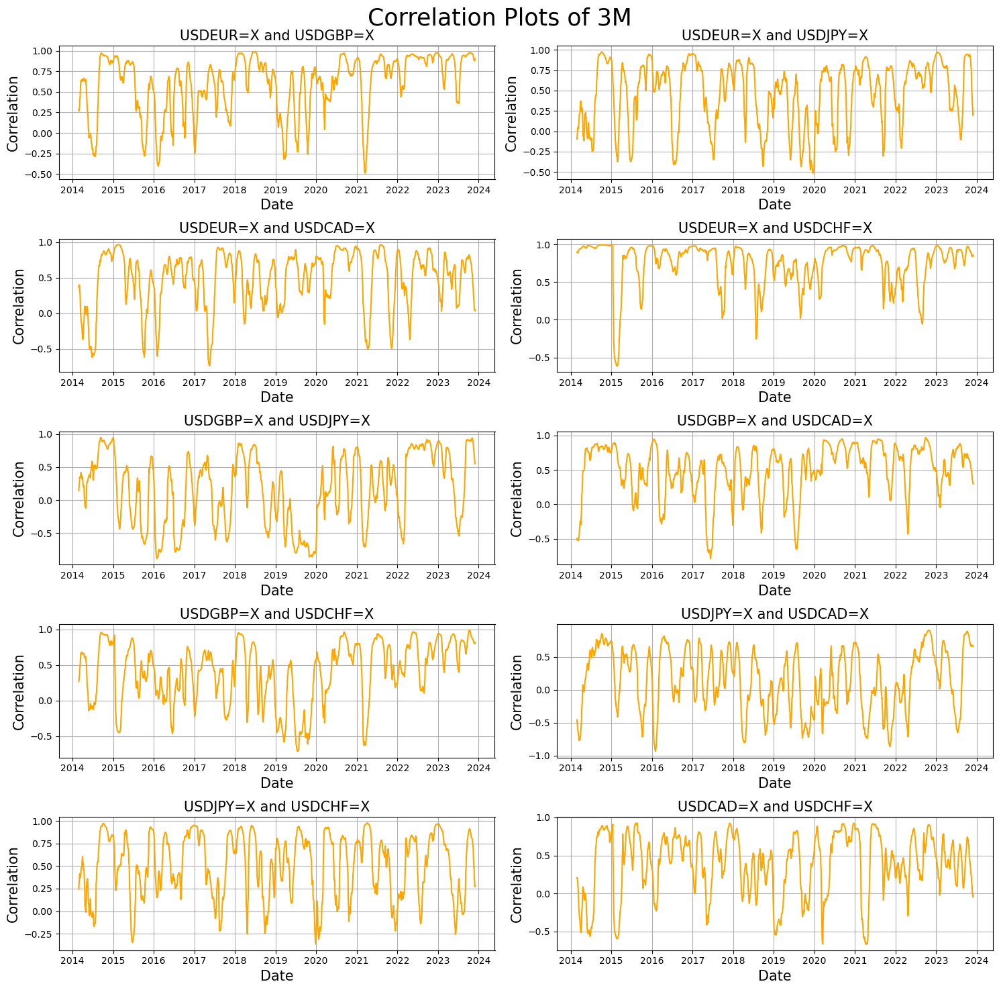

In [201]:
MCPPlot(MCP_3M_corr,'3M')

## 6M

In [180]:
MCP_6M_corr = MCP.rolling(window = _6M).corr(pairwise=True)
MCP_6M_corr = MCP_6M_corr.dropna()
MCP_6M_corr

USDCAD=X  USDCHF=X  USDEUR=X  USDGBP=X  USDJPY=X
Date                                                                 
2014-05-26 USDCAD=X  1.000000 -0.283391 -0.182282 -0.376814 -0.451341
           USDCHF=X -0.283391  1.000000  0.958670  0.608365  0.481806
           USDEUR=X -0.182282  0.958670  1.000000  0.587954  0.300786
           USDGBP=X -0.376814  0.608365  0.587954  1.000000  0.494425
           USDJPY=X -0.451341  0.481806  0.300786  0.494425  1.000000
...                       ...       ...       ...       ...       ...
2023-11-30 USDCAD=X  1.000000  0.446147  0.707547  0.790773  0.890824
           USDCHF=X  0.446147  1.000000  0.863604  0.806919  0.555905
           USDEUR=X  0.707547  0.863604  1.000000  0.951392  0.746377
           USDGBP=X  0.790773  0.806919  0.951392  1.000000  0.837590
           USDJPY=X  0.890824  0.555905  0.746377  0.837590  1.000000

[12405 rows x 5 columns]

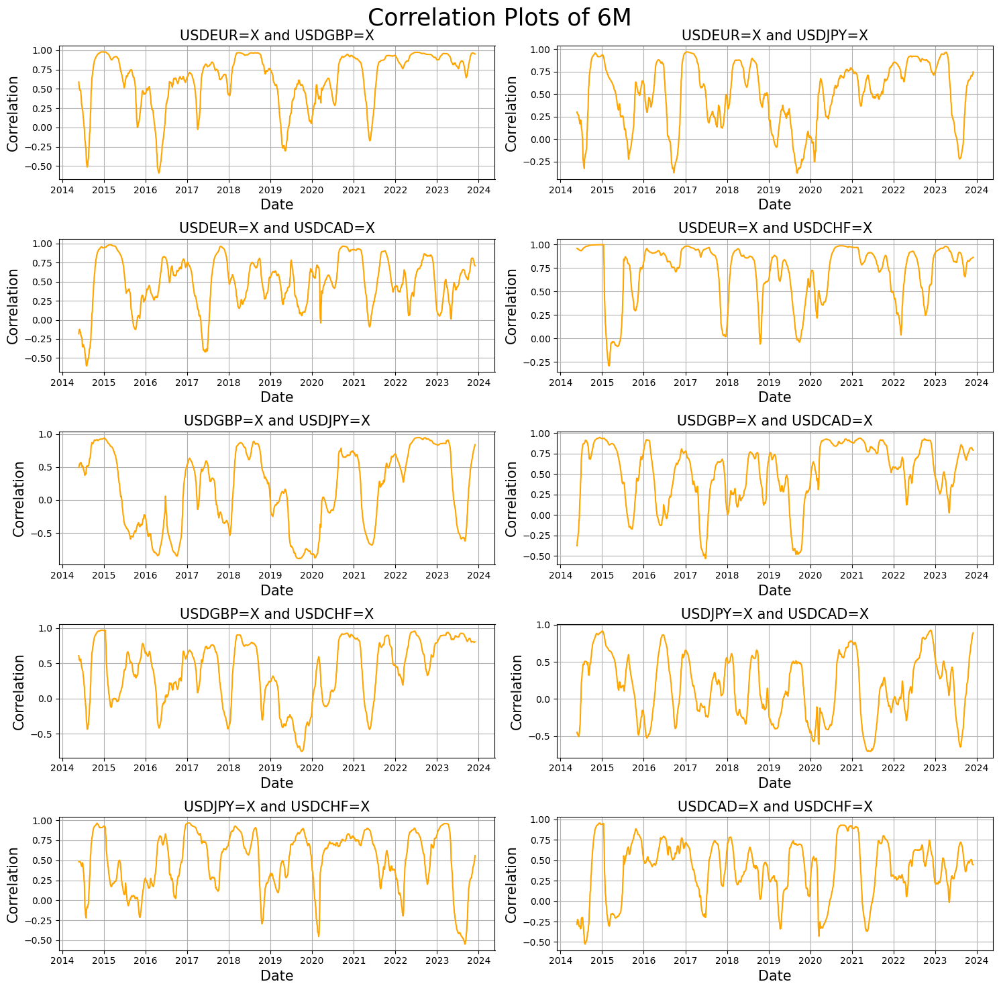

In [202]:
MCPPlot(MCP_6M_corr,'6M')

## 1Y

In [196]:
MCP_1Y_corr = MCP.rolling(window = _1Y).corr(pairwise=True)
MCP_1Y_corr = MCP_1Y_corr.dropna()
MCP_1Y_corr

USDCAD=X  USDCHF=X  USDEUR=X  USDGBP=X  USDJPY=X
Date                                                                 
2014-11-18 USDCAD=X  1.000000  0.531618  0.554621  0.567196  0.571896
           USDCHF=X  0.531618  1.000000  0.988523  0.761517  0.879764
           USDEUR=X  0.554621  0.988523  1.000000  0.725444  0.872421
           USDGBP=X  0.567196  0.761517  0.725444  1.000000  0.824215
           USDJPY=X  0.571896  0.879764  0.872421  0.824215  1.000000
...                       ...       ...       ...       ...       ...
2023-11-30 USDCAD=X  1.000000  0.328514  0.622738  0.602691  0.279663
           USDCHF=X  0.328514  1.000000  0.697387  0.869998 -0.484254
           USDEUR=X  0.622738  0.697387  1.000000  0.828043  0.191171
           USDGBP=X  0.602691  0.869998  0.828043  1.000000 -0.227248
           USDJPY=X  0.279663 -0.484254  0.191171 -0.227248  1.000000

[11775 rows x 5 columns]

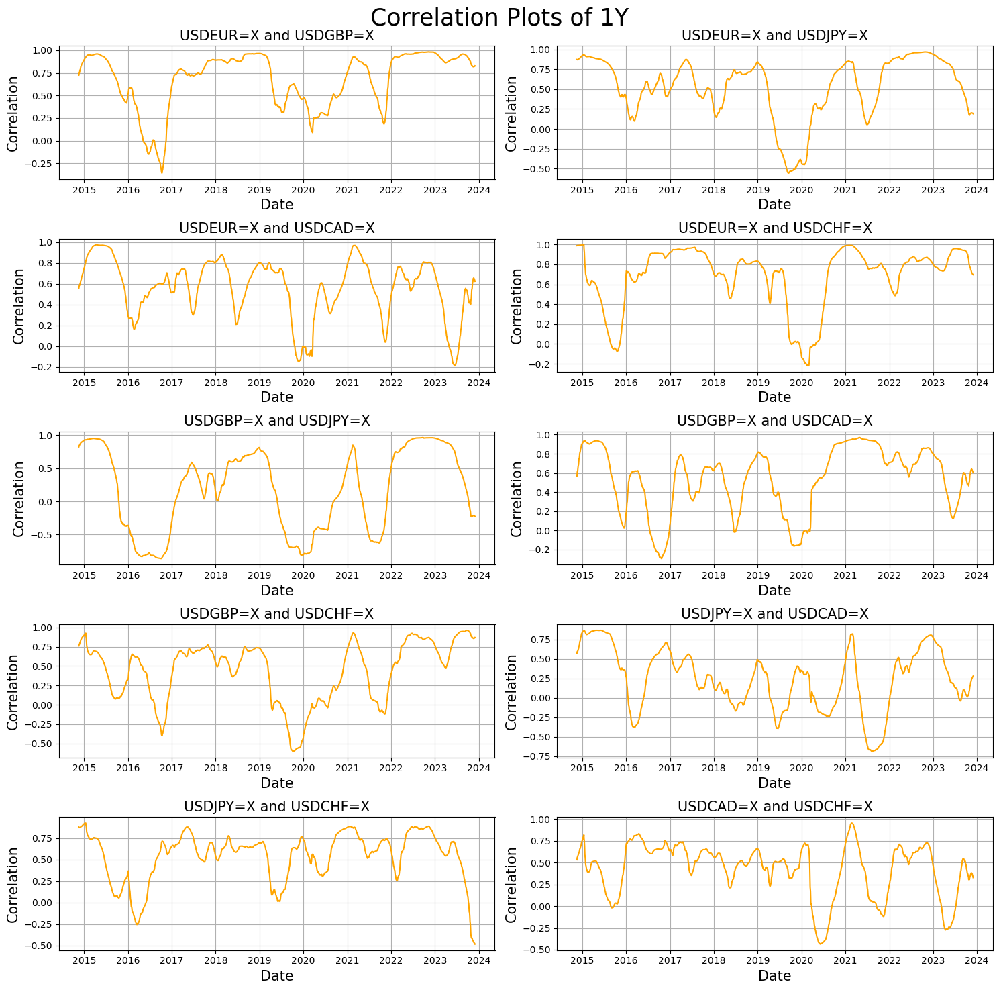

In [203]:
MCPPlot(MCP_1Y_corr,'1Y')

## Interest Rates

In [22]:
USD = pd.read_csv('United States 10-Year Bond Yield Historical Data.csv')
USD = USD[::-1]
USD['Date'] = pd.to_datetime(USD['Date'])
USD.set_index('Date', inplace=True)
USD = pd.DataFrame(USD['2013-11-30':'2023-11-30']['Price'])
USD.rename(columns={'Price': 'USD'}, inplace=True)


GBP = pd.read_csv('United Kingdom 10-Year Bond Yield Historical Data.csv')
GBP = GBP[::-1]
GBP['Date'] = pd.to_datetime(GBP['Date'])
GBP.set_index('Date', inplace=True)
GBP = pd.DataFrame(GBP['2013-11-30':'2023-11-30']['Price'])
GBP.rename(columns={'Price': 'GBP'}, inplace=True)

JPY = pd.read_csv('Japan 10-Year Bond Yield Historical Data.csv')
JPY = JPY[::-1]
JPY['Date'] = pd.to_datetime(JPY['Date'])
JPY.set_index('Date', inplace=True)
JPY = pd.DataFrame(JPY['2013-11-30':'2023-11-30']['Price'])
JPY.rename(columns={'Price': 'JPY'}, inplace=True)

CAD = pd.read_csv('Canada 10-Year Bond Yield Historical Data.csv')
CAD = CAD[::-1]
CAD['Date'] = pd.to_datetime(CAD['Date'])
CAD.set_index('Date', inplace=True)
CAD = pd.DataFrame(CAD['2013-11-30':'2023-11-30']['Price'])
CAD.rename(columns={'Price': 'CAD'}, inplace=True)

CHF = pd.read_csv('Switzerland 10-Year Bond Yield Historical Data.csv')
CHF = CHF[::-1]
CHF['Date'] = pd.to_datetime(CHF['Date'])
CHF.set_index('Date', inplace=True)
CHF = pd.DataFrame(CHF['2013-11-30':'2023-11-30']['Price'])
CHF.rename(columns={'Price': 'CHF'}, inplace=True)

In [23]:
IR = pd.merge(USD, GBP, on='Date', how='inner')
IR = pd.merge(IR, JPY, on='Date', how='inner')
IR = pd.merge(IR, CAD, on='Date', how='inner')
IR = pd.merge(IR, CHF, on='Date', how='inner')
IR

,USD,GBP,JPY,CAD,CHF
Date,,,,,
2013-12-02,2.797,2.848,0.617,2.604,0.895
2013-12-03,2.784,2.815,0.636,2.589,0.915
2013-12-04,2.837,2.902,0.633,2.652,0.943
2013-12-05,2.873,2.919,0.634,2.678,0.961
2013-12-06,2.857,2.901,0.675,2.692,0.973
...,...,...,...,...,...
2023-11-24,4.472,4.283,0.771,3.717,1.036
2023-11-27,4.390,4.212,0.775,3.656,0.961
2023-11-28,4.325,4.172,0.756,3.579,0.917


In [24]:
IRs = ['USD','GBP','JPY','CAD','CHF']

In [250]:
def IRPlot(cor, tenor):
    %matplotlib inline
    fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 15)) #, sharex=True, sharey=True

    k = 0

    for i in range(4):
        for j in range(i+1,5):

            ax = axes[k//2,k%2]
            ax.set_title("{} and {}".format(IRs[i], IRs[j]), fontsize = 15)
            ax.set_xlabel("Date", fontsize = 15)
            ax.set_ylabel("Correlation", fontsize = 15)
            y = cor.loc[(slice(None), IRs[i]), IRs[j]]
            y.index = y.index.get_level_values(0)
            ax.plot(y,color = 'green')
            ax.grid(True)
            k += 1

    fig.suptitle("Correlation Plots of %s" %tenor, fontsize=25)

    plt.tight_layout()
    plt.show()

### 1M

In [244]:
IR_1M_corr = IR.rolling(window = _1M).corr(pairwise=True)
IR_1M_corr = IR_1M_corr.dropna()
IR_1M_corr

USD       GBP       JPY       CAD       CHF
Date                                                            
2014-01-07 USD  1.000000  0.917584  0.762010  0.918302  0.779431
           GBP  0.917584  1.000000  0.749506  0.945286  0.705016
           JPY  0.762010  0.749506  1.000000  0.739561  0.829990
           CAD  0.918302  0.945286  0.739561  1.000000  0.664187
           CHF  0.779431  0.705016  0.829990  0.664187  1.000000
...                  ...       ...       ...       ...       ...
2023-11-30 USD  1.000000  0.905270  0.890888  0.991855  0.851926
           GBP  0.905270  1.000000  0.850208  0.889763  0.755446
           JPY  0.890888  0.850208  1.000000  0.879454  0.882294
           CAD  0.991855  0.889763  0.879454  1.000000  0.836525
           CHF  0.851926  0.755446  0.882294  0.836525  1.000000

[11895 rows x 5 columns]

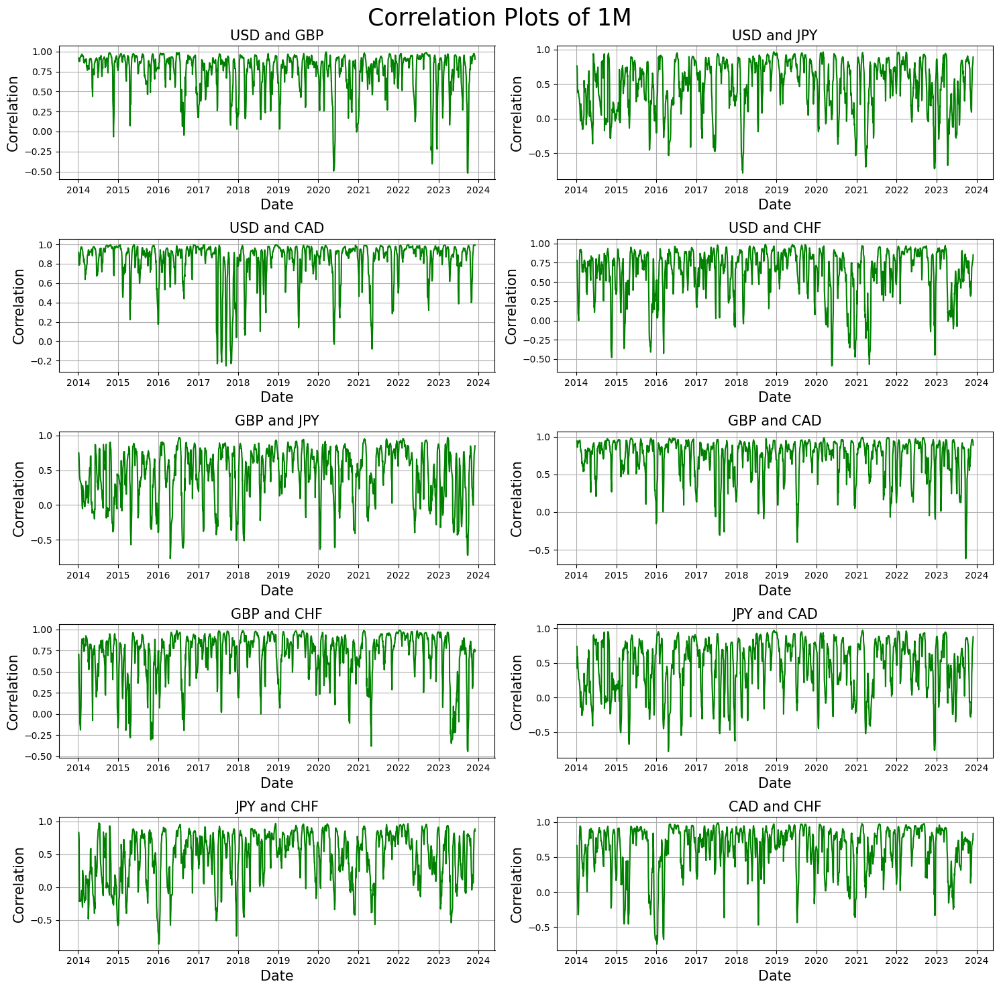

In [251]:
IRPlot(IR_1M_corr,'1M')

### 3M

In [252]:
IR_3M_corr = IR.rolling(window = _3M).corr(pairwise=True)
IR_3M_corr = IR_1M_corr.dropna()
IR_3M_corr

USD       GBP       JPY       CAD       CHF
Date                                                            
2014-01-07 USD  1.000000  0.917584  0.762010  0.918302  0.779431
           GBP  0.917584  1.000000  0.749506  0.945286  0.705016
           JPY  0.762010  0.749506  1.000000  0.739561  0.829990
           CAD  0.918302  0.945286  0.739561  1.000000  0.664187
           CHF  0.779431  0.705016  0.829990  0.664187  1.000000
...                  ...       ...       ...       ...       ...
2023-11-30 USD  1.000000  0.905270  0.890888  0.991855  0.851926
           GBP  0.905270  1.000000  0.850208  0.889763  0.755446
           JPY  0.890888  0.850208  1.000000  0.879454  0.882294
           CAD  0.991855  0.889763  0.879454  1.000000  0.836525
           CHF  0.851926  0.755446  0.882294  0.836525  1.000000

[11895 rows x 5 columns]

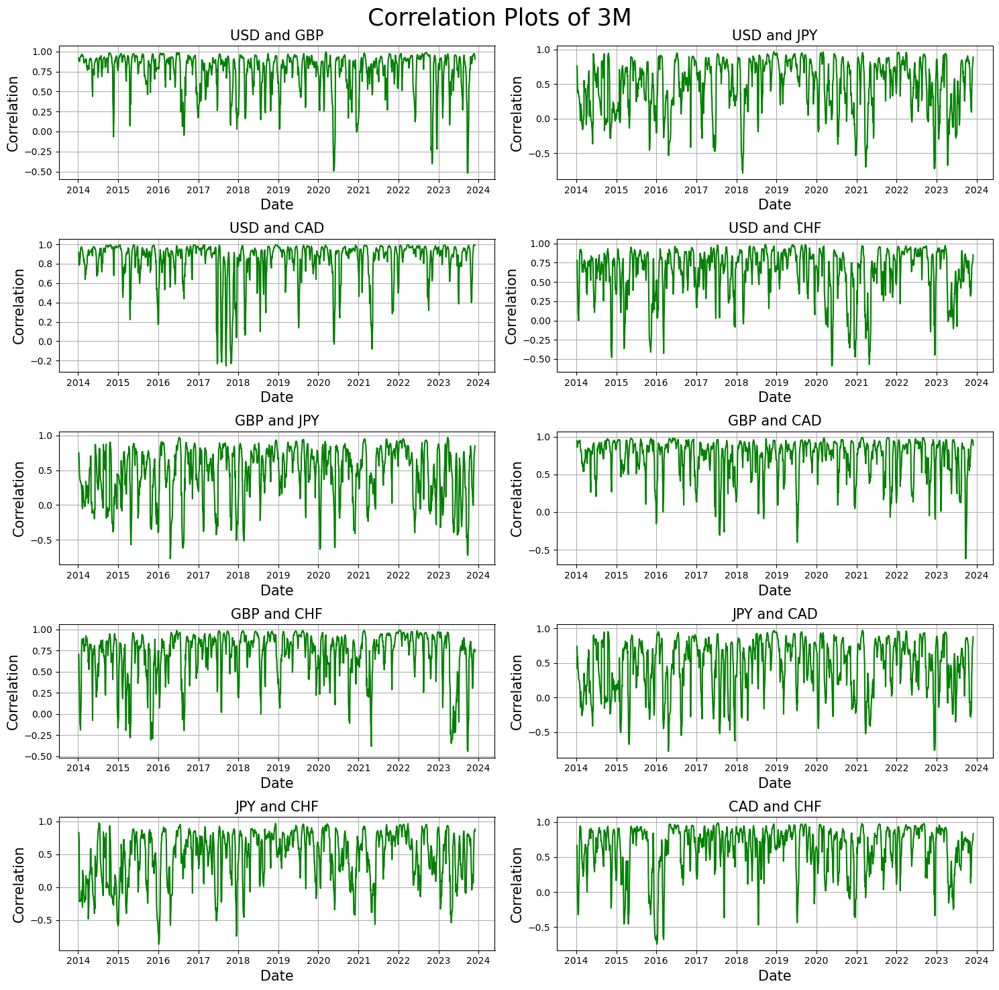

In [253]:
IRPlot(IR_3M_corr,'3M')

### 6M

In [254]:
IR_6M_corr = IR.rolling(window = _6M).corr(pairwise=True)
IR_6M_corr = IR_6M_corr.dropna()
IR_6M_corr

USD       GBP       JPY       CAD       CHF
Date                                                            
2014-06-12 USD  1.000000  0.940694  0.263642  0.951304  0.816261
           GBP  0.940694  1.000000  0.276988  0.912258  0.757352
           JPY  0.263642  0.276988  1.000000  0.253697  0.144855
           CAD  0.951304  0.912258  0.253697  1.000000  0.699421
           CHF  0.816261  0.757352  0.144855  0.699421  1.000000
...                  ...       ...       ...       ...       ...
2023-11-30 USD  1.000000  0.339305  0.943479  0.950279  0.693501
           GBP  0.339305  1.000000  0.166036  0.430543  0.526504
           JPY  0.943479  0.166036  1.000000  0.862333  0.599209
           CAD  0.950279  0.430543  0.862333  1.000000  0.748287
           CHF  0.693501  0.526504  0.599209  0.748287  1.000000

[11370 rows x 5 columns]

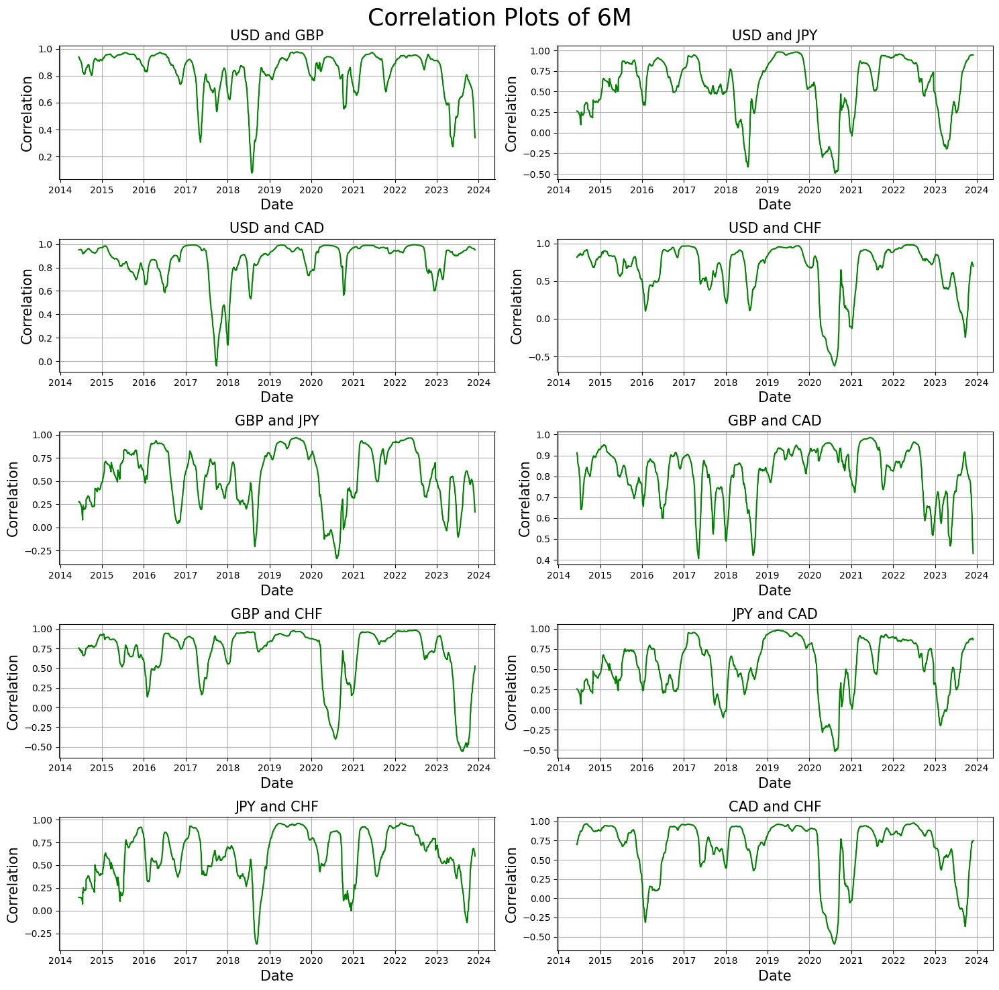

In [255]:
IRPlot(IR_6M_corr,'6M')

### 1Y

In [256]:
IR_1Y_corr = IR.rolling(window = _1Y).corr(pairwise=True)
IR_1Y_corr = IR_1Y_corr.dropna()
IR_1Y_corr

USD       GBP       JPY       CAD       CHF
Date                                                            
2014-12-08 USD  1.000000  0.937843  0.521160  0.976924  0.911689
           GBP  0.937843  1.000000  0.524764  0.918475  0.870371
           JPY  0.521160  0.524764  1.000000  0.527616  0.497679
           CAD  0.976924  0.918475  0.527616  1.000000  0.934650
           CHF  0.911689  0.870371  0.497679  0.934650  1.000000
...                  ...       ...       ...       ...       ...
2023-11-30 USD  1.000000  0.730068  0.874930  0.958006 -0.097442
           GBP  0.730068  1.000000  0.683926  0.848687 -0.365774
           JPY  0.874930  0.683926  1.000000  0.849905 -0.041687
           CAD  0.958006  0.848687  0.849905  1.000000 -0.155002
           CHF -0.097442 -0.365774 -0.041687 -0.155002  1.000000

[10740 rows x 5 columns]

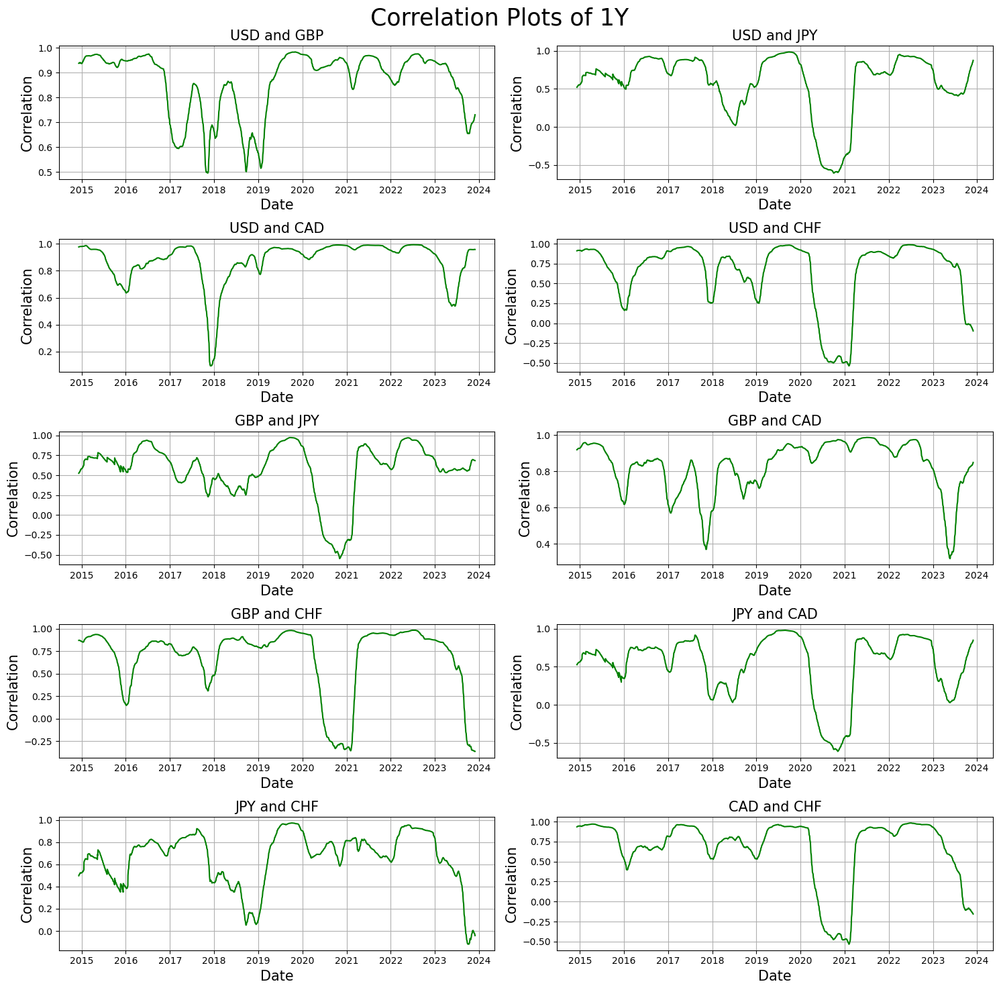

In [257]:
IRPlot(IR_1Y_corr,'1Y')

### <span style="color:blue">(b) What do you conclude?</span>

__Conclusions__:

__1) The correlation time series of Main Currency Pairs and Interest Rate are changing, which shows that indices are not stationary. This is same with the conclusion in Indices Part.__

__2) When the window size becomes larger (1M -> 3M -> 6M -> 1Y), the correlation changes less dramatically, which shows that indices become more stationary.__

__3) In these 3 assets, the Correlation of Main Currency Pairs is the most stable one, then is Interest Rate, and the most instable one is Indices.__

__4) Compared with Indices and Interest Rates, the Correlation of Main Currency Pairs is more like close to 1 for some time.__

### <span style="color:blue"><center>3. Asset Distribution (10 pts)</span><center>

### <span style="color:blue">(a) For the S&P 500 and 3 major index of your choice, compute the time series of the correlation.</span>

I have double checked with Prof. that this is by mistake the same question as 1(a). So no need to do it again.

### <span style="color:blue">(b) Draw histogram of the distribution of each asset return over the most recent data estimated over 1M, 3M, 6M, 1Y, 2Y, 5Y and 10Y.</span>

In [72]:
AR_Indices = Indices.diff()
AR_Indices

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2013-12-02,NaN,NaN,NaN,NaN
2013-12-03,-5.750000,-63.350098,-62.899902,-147.430176
2013-12-04,-2.339966,-22.119873,-22.399902,-64.350098
2013-12-05,-7.780029,-38.590088,-11.700195,-19.950195
2013-12-06,20.059937,26.770020,53.700195,40.479980
...,...,...,...,...
2023-11-24,2.719727,20.080078,18.700195,47.129883
2023-11-27,-8.909668,-17.689941,-27.500000,-58.459961
2023-11-28,4.459961,-6.390137,-5.500000,-60.679688


In [60]:
Log_Indices = np.log(Indices)
Log_Indices

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2013-12-02,7.496042,8.031785,8.794113,9.018855
2013-12-03,7.492844,8.010984,8.784530,9.000840
2013-12-04,7.491540,8.003617,8.781095,8.992873
2013-12-05,7.487191,7.990634,8.779296,8.990390
2013-12-06,7.498366,7.999658,8.787526,8.995422
...,...,...,...,...
2023-11-24,8.424933,8.382999,8.921084,9.294637
2023-11-27,8.422977,8.378944,8.917405,9.289249
2023-11-28,8.423957,8.377476,8.916667,9.283626


In [61]:
LR_Indices = Log_Indices.diff()
LR_Indices = LR_Indices.dropna()
LR_Indices

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2013-12-03,-0.003198,-0.020802,-0.009583,-0.018016
2013-12-04,-0.001304,-0.007366,-0.003435,-0.007966
2013-12-05,-0.004349,-0.012983,-0.001799,-0.002483
2013-12-06,0.011175,0.009024,0.008230,0.005031
2013-12-09,0.001815,0.002925,0.001144,-0.001208
...,...,...,...,...
2023-11-24,0.000597,0.004603,0.002500,0.004341
2023-11-27,-0.001956,-0.004054,-0.003679,-0.005388
2023-11-28,0.000980,-0.001469,-0.000737,-0.005623


In [25]:
_2Y = 252*2
_5Y = 252*5
_10Y = 252*10

In [26]:
recent_tenors_int = [_1M, _3M, _6M, _1Y, _2Y, _5Y, _10Y]

In [27]:
recent_tenors_str = ['1M', '3M', '6M', '1Y', '2Y', '5Y', '10Y']

In [83]:
def R_Hist(df,asset,isIR):
    %matplotlib inline
    
    if not isIR:
        Log_df = np.log(df)
        R_df = Log_df.diff()
    else:
        R_df = df.diff()
    
    R_df = R_df.dropna()
    
    rownum = len(recent_tenors_str)
    colnum = len(asset)
    fig, axes = plt.subplots(nrows=rownum, ncols=colnum, figsize=(20, 30)) #, sharex=True, sharey=True

    for i in range(rownum):
        for j in range(colnum):
            # i is time tenor no.
            # j is index no.
            ax = axes[i,j]
            
            ax.set_title("{} {}".format(asset[j], recent_tenors_str[i]), fontsize = 15)
            ax.set_xlabel("Value", fontsize = 15)
            ax.set_ylabel("Density", fontsize = 15)
            ax.hist(R_df.iloc[-recent_tenors_int[i]:, j], density=True, bins='auto', histtype='stepfilled')
            ax.grid(True)

    plt.tight_layout()
    plt.show()

### <center>Distribution of Recent Indices' Log Return<center>

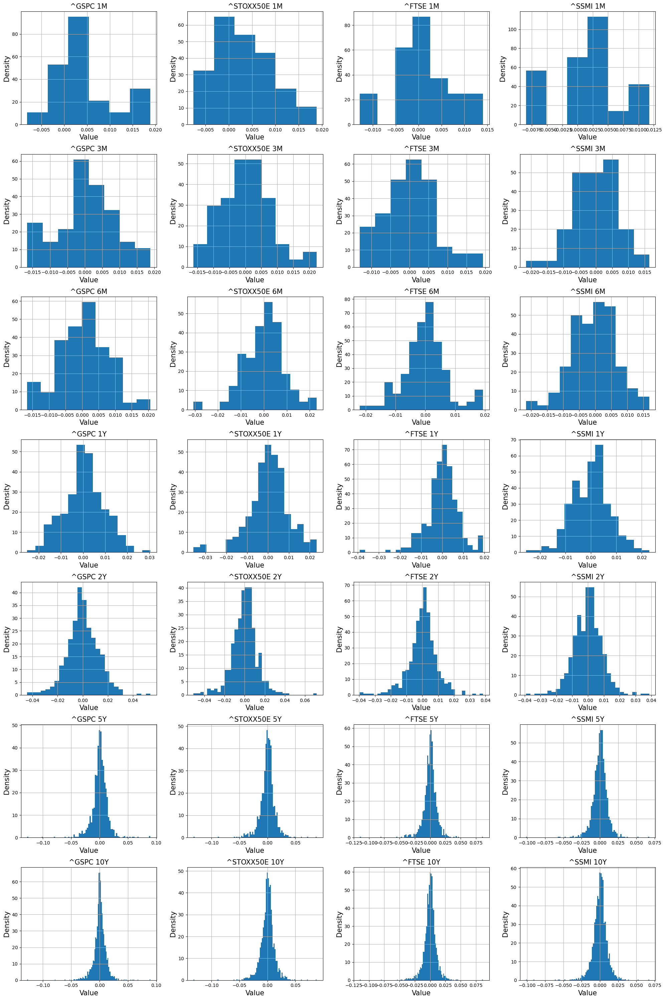

In [84]:
R_Hist(Indices, symbols, False)

### <span style="color:blue">(c) Do asset returns follow a Gaussian distribution? If not, what distribution can you try to fit?</span>

### Gaussian Distribution

In [28]:
from scipy.stats import probplot
import statsmodels.api as sm

In [163]:
def R_norm_qqPlot(df,asset,isIR):
    %matplotlib inline
    
    if not isIR:
        Log_df = np.log(df)
        R_df = Log_df.diff()
    else:
        R_df = df.diff()
        
    R_df = R_df.dropna()

    rownum = len(recent_tenors_str)
    colnum = len(asset)
    fig, axes = plt.subplots(nrows=rownum, ncols=colnum, figsize=(20, 30)) #, sharex=True, sharey=True
    
    for i in range(rownum):
        for j in range(colnum):
            # i is time tenor no.
            # j is index no.
            ax = axes[i,j]
            # Create a Q-Q plot
            #if i < rownum-1:
                #sm.qqplot(np.array(R_df.iloc[-recent_tenors_int[i]:, j]), line='45', fit=True, ax = ax)
            #else:
                #sm.qqplot(np.array(R_df.iloc[:, j]), line='45', fit=True, ax = ax)
            probplot(R_df.iloc[-recent_tenors_int[i]:, j], dist='norm', plot=ax)
            ax.set_title("{} {}".format(asset[j], recent_tenors_str[i]), fontsize = 15)
            ax.grid(True)
    

    plt.tight_layout()
    plt.show()

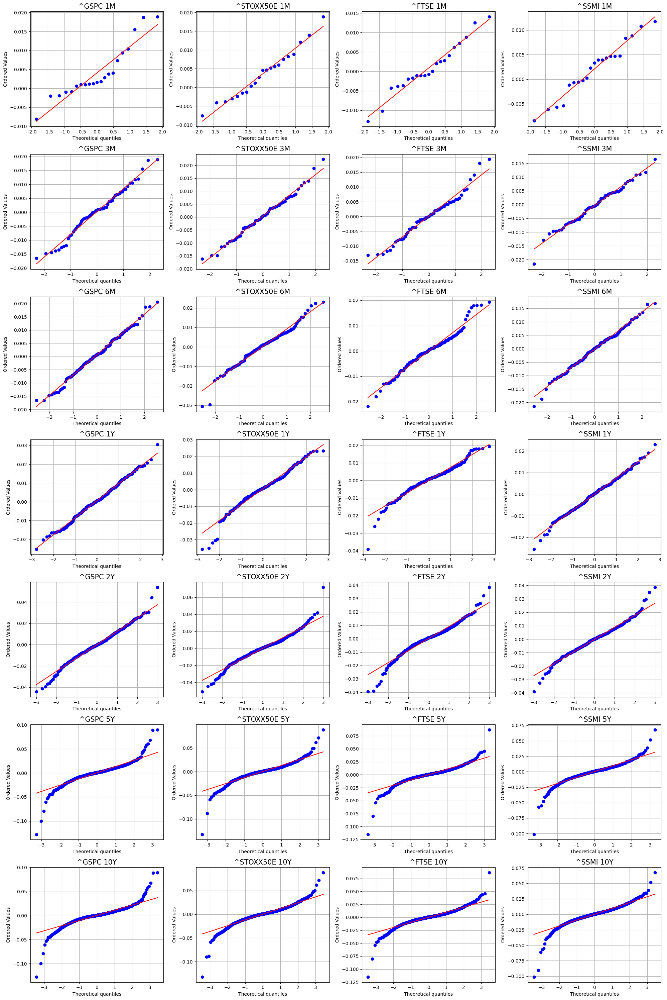

In [164]:
R_norm_qqPlot(Indices, symbols, False)

__So, according to the QQPlot, the Indice returns do not follow a Gaussian distribution.__

__This is reasonable, because financial data usually has fat tail, because of high frequency of extreme values.__

__Therefore, I try to use T-distribution to fit these data.__

### Student T (degree of freedom = 4)

In [99]:
def R_t_qqPlot(df,asset,isIR,degree):
    %matplotlib inline
    
    if not isIR:
        Log_df = np.log(df)
        R_df = Log_df.diff()
    else:
        R_df = df.diff()
        
    R_df = R_df.dropna()
    
    rownum = len(recent_tenors_str)
    colnum = len(asset)
    fig, axes = plt.subplots(nrows=rownum, ncols=colnum, figsize=(20, 30)) #, sharex=True, sharey=True
    
    for i in range(rownum):
        for j in range(colnum):
            # i is time tenor no.
            # j is index no.
            ax = axes[i,j]
            
            # Create a Q-Q plot
            #sm.qqplot(np.array(R_df.iloc[-recent_tenors_int[i]:, j]), line='45', fit=True, ax = ax)
            probplot(np.array(R_df.iloc[-recent_tenors_int[i]:, j]), dist='t', sparams = (degree,), plot=ax)
            #ax.plot([0, 1], [0, 1], linestyle='-', color='r')
            ax.set_title("{} {}".format(asset[j], recent_tenors_str[i]), fontsize = 15)
            ax.grid(True)

    plt.tight_layout()
    plt.show()

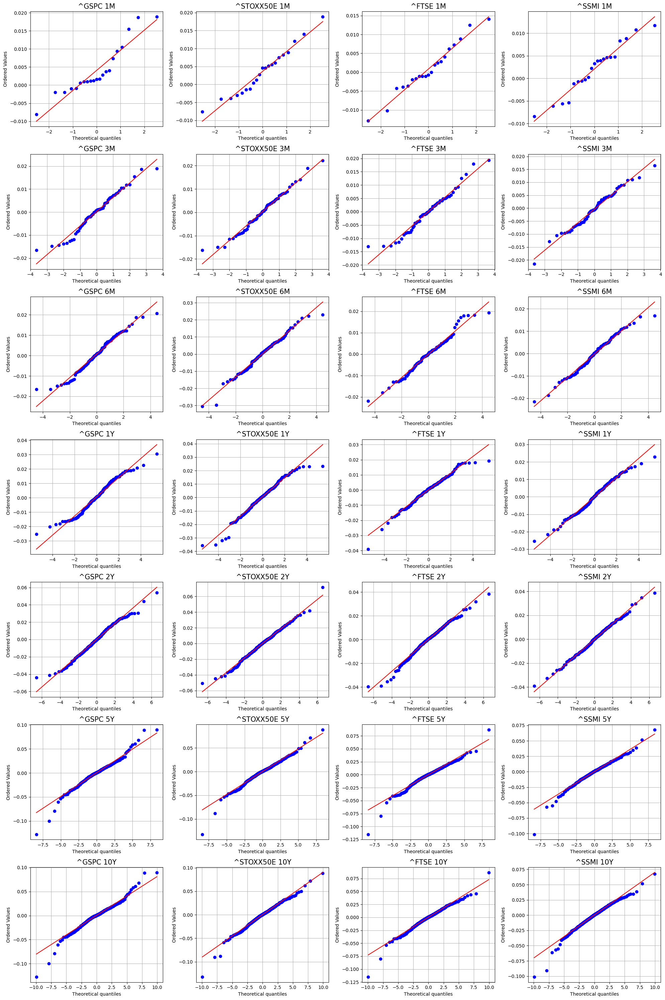

In [100]:
R_t_qqPlot(Indices, symbols, False, 4)

__So, according to the QQPlot, Student T distribution (with degree of freedom = 4) fits the Indice returns much better.__

__However, there are still some outliers.__

### <span style="color:blue">(d) Compute time series of rolling statistics for the average variance, skew and kurtosis.</span>

### 1M

In [116]:
Indices_1M_mean = LR_Indices.rolling(window = _1M).mean()
Indices_1M_mean = Indices_1M_mean.dropna()
Indices_1M_mean

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-01-08,0.000958,0.000515,0.000905,0.000548
2014-01-09,0.001127,0.001192,0.001144,0.001080
2014-01-10,0.001299,0.001756,0.001653,0.001855
2014-01-13,0.000903,0.002494,0.001860,0.002244
2014-01-14,0.000883,0.002180,0.001537,0.001845
...,...,...,...,...
2023-11-24,0.004059,0.003370,0.000472,0.002142
2023-11-27,0.004533,0.003458,0.000682,0.002038
2023-11-28,0.004809,0.003802,0.001059,0.001973


In [117]:
Indices_1M_var = LR_Indices.rolling(window = _1M).var()
Indices_1M_var = Indices_1M_var.dropna()
Indices_1M_var

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-01-08,0.000040,0.000117,0.000049,0.000072
2014-01-09,0.000039,0.000097,0.000045,0.000057
2014-01-10,0.000038,0.000093,0.000045,0.000055
2014-01-13,0.000046,0.000082,0.000045,0.000055
2014-01-14,0.000046,0.000080,0.000042,0.000056
...,...,...,...,...
2023-11-24,0.000065,0.000052,0.000050,0.000029
2023-11-27,0.000054,0.000051,0.000047,0.000030
2023-11-28,0.000050,0.000045,0.000043,0.000031


In [118]:
Indices_1M_skew = LR_Indices.rolling(window = _1M).skew()
Indices_1M_skew = Indices_1M_skew.dropna()
Indices_1M_skew

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-01-08,0.634952,-0.035975,0.499848,-0.359053
2014-01-09,0.582997,0.265348,0.634882,0.025961
2014-01-10,0.500662,0.126877,0.430975,-0.168901
2014-01-13,0.126903,0.122374,0.344225,-0.326493
2014-01-14,0.115956,0.222536,0.483673,-0.166128
...,...,...,...,...
2023-11-24,0.186514,0.179327,0.061248,-0.035110
2023-11-27,0.568021,0.205606,0.060666,-0.061968
2023-11-28,0.624393,0.390045,0.039591,-0.084693


In [119]:
Indices_1M_kurt = LR_Indices.rolling(window = _1M).kurt()
Indices_1M_kurt = Indices_1M_kurt.dropna()
Indices_1M_kurt

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-01-08,0.807884,-0.909721,-0.593016,0.024592
2014-01-09,0.908435,-1.279911,-0.538905,-0.352637
2014-01-10,0.892163,-1.216418,-0.783823,-0.196866
2014-01-13,0.674623,-1.111638,-0.775003,-0.094258
2014-01-14,0.698580,-0.966260,-0.457790,-0.264258
...,...,...,...,...
2023-11-24,-0.127415,-0.386826,-0.219444,-0.376051
2023-11-27,-0.268225,-0.320955,0.019470,-0.489414
2023-11-28,-0.088309,-0.197568,0.466007,-0.545772


### 3M

In [122]:
Indices_3M_mean = LR_Indices.rolling(window = _3M).mean()
Indices_3M_mean = Indices_3M_mean.dropna()
Indices_3M_mean

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-03-11,0.000578,0.000079,0.000216,0.000195
2014-03-12,0.000633,0.000269,0.000214,0.000388
2014-03-13,0.000467,0.000147,0.000106,0.000313
2014-03-14,0.000491,0.000274,0.000072,0.000174
2014-03-17,0.000466,0.000365,0.000040,0.000187
...,...,...,...,...
2023-11-24,0.000650,0.000516,0.000331,-0.000141
2023-11-27,0.000513,0.000437,0.000262,-0.000198
2023-11-28,0.000201,0.000079,-0.000021,-0.000502


In [123]:
Indices_3M_var = LR_Indices.rolling(window = _3M).var()
Indices_3M_var = Indices_3M_var.dropna()
Indices_3M_var

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-03-11,0.000057,0.000110,0.000056,0.000069
2014-03-12,0.000057,0.000104,0.000056,0.000064
2014-03-13,0.000059,0.000107,0.000057,0.000066
2014-03-14,0.000059,0.000105,0.000057,0.000068
2014-03-17,0.000059,0.000107,0.000057,0.000068
...,...,...,...,...
2023-11-24,0.000072,0.000069,0.000053,0.000048
2023-11-27,0.000072,0.000069,0.000053,0.000048
2023-11-28,0.000065,0.000063,0.000048,0.000046


In [124]:
Indices_3M_skew = LR_Indices.rolling(window = _3M).skew()
Indices_3M_skew = Indices_3M_skew.dropna()
Indices_3M_skew

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-03-11,-0.553419,-0.441567,0.276404,-0.647834
2014-03-12,-0.577514,-0.405396,0.275456,-0.607871
2014-03-13,-0.545284,-0.400345,0.267037,-0.608236
2014-03-14,-0.554998,-0.419579,0.277310,-0.574488
2014-03-17,-0.569404,-0.398958,0.281900,-0.575598
...,...,...,...,...
2023-11-24,0.068225,0.373776,0.376032,-0.174401
2023-11-27,0.112626,0.397930,0.400030,-0.153932
2023-11-28,-0.008454,0.309830,0.349035,-0.176536


In [125]:
Indices_3M_kurt = LR_Indices.rolling(window = _3M).kurt()
Indices_3M_kurt = Indices_3M_kurt.dropna()
Indices_3M_kurt

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-03-11,1.370467,1.226615,0.677779,1.317664
2014-03-12,1.423920,1.456517,0.675338,1.599382
2014-03-13,1.128925,1.274462,0.552336,1.444007
2014-03-14,1.163061,1.451820,0.532316,1.200881
2014-03-17,1.198424,1.343903,0.582024,1.188521
...,...,...,...,...
2023-11-24,-0.101878,0.282431,0.441333,0.591118
2023-11-27,-0.057736,0.267326,0.424419,0.530053
2023-11-28,-0.095114,0.290002,0.582814,0.628559


### 6M

In [126]:
Indices_6M_mean = LR_Indices.rolling(window = _6M).mean()
Indices_6M_mean = Indices_6M_mean.dropna()
Indices_6M_mean

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-06-17,0.000599,0.000495,0.000204,0.000385
2014-06-18,0.000685,0.000670,0.000294,0.000518
2014-06-19,0.000706,0.000814,0.000355,0.000597
2014-06-20,0.000754,0.000887,0.000390,0.000642
2014-06-23,0.000664,0.000768,0.000296,0.000550
...,...,...,...,...
2023-11-24,0.000755,0.000054,-0.000286,-0.000430
2023-11-27,0.000798,0.000167,-0.000175,-0.000402
2023-11-28,0.000736,0.000144,-0.000122,-0.000406


In [127]:
Indices_6M_var = LR_Indices.rolling(window = _6M).var()
Indices_6M_var = Indices_6M_var.dropna()
Indices_6M_var

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-06-17,0.000049,0.000088,0.000042,0.000051
2014-06-18,0.000050,0.000084,0.000041,0.000048
2014-06-19,0.000050,0.000085,0.000041,0.000047
2014-06-20,0.000049,0.000083,0.000041,0.000047
2014-06-23,0.000049,0.000083,0.000041,0.000047
...,...,...,...,...
2023-11-24,0.000060,0.000085,0.000057,0.000050
2023-11-27,0.000060,0.000083,0.000054,0.000049
2023-11-28,0.000059,0.000083,0.000054,0.000049


In [128]:
Indices_6M_skew = LR_Indices.rolling(window = _6M).skew()
Indices_6M_skew = Indices_6M_skew.dropna()
Indices_6M_skew

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-06-17,-0.668095,-0.397020,0.165895,-0.658663
2014-06-18,-0.690293,-0.379800,0.156564,-0.621032
2014-06-19,-0.699578,-0.409407,0.130847,-0.651832
2014-06-20,-0.721658,-0.416893,0.115274,-0.671018
2014-06-23,-0.729084,-0.387536,0.144688,-0.636322
...,...,...,...,...
2023-11-24,0.002029,-0.307916,0.010486,-0.149615
2023-11-27,-0.005803,-0.294265,0.071179,-0.152025
2023-11-28,0.009588,-0.286691,0.057797,-0.150932


In [129]:
Indices_6M_kurt = LR_Indices.rolling(window = _6M).kurt()
Indices_6M_kurt = Indices_6M_kurt.dropna()
Indices_6M_kurt

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-06-17,1.165276,0.903535,0.733613,1.613097
2014-06-18,1.159630,1.040702,0.818621,1.784771
2014-06-19,1.172919,1.045622,0.810209,1.912335
2014-06-20,1.224965,1.151341,0.807730,1.935441
2014-06-23,1.298660,1.143401,0.868354,1.854402
...,...,...,...,...
2023-11-24,-0.170378,1.093241,0.783258,0.155411
2023-11-27,-0.134743,1.231703,0.857031,0.191843
2023-11-28,-0.093830,1.227776,0.908304,0.186839


### 1Y

In [131]:
Indices_1Y_mean= LR_Indices.rolling(window = _1Y).mean()
Indices_1Y_mean = Indices_1Y_mean.dropna()
Indices_1Y_mean

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-12-17,0.000442,-0.000033,-0.000159,0.000242
2014-12-18,0.000548,0.000180,-0.000041,0.000419
2014-12-19,0.000572,0.000194,0.000021,0.000434
2014-12-22,0.000604,0.000262,0.000048,0.000469
2014-12-23,0.000567,0.000273,0.000028,0.000444
...,...,...,...,...
2023-11-24,0.000526,0.000486,0.000091,-0.000089
2023-11-27,0.000554,0.000450,0.000040,-0.000065
2023-11-28,0.000524,0.000416,0.000046,-0.000097


In [132]:
Indices_1Y_var= LR_Indices.rolling(window = _1Y).var()
Indices_1Y_var = Indices_1Y_var.dropna()
Indices_1Y_var

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-12-17,0.000051,0.000120,0.000053,0.000054
2014-12-18,0.000053,0.000123,0.000054,0.000055
2014-12-19,0.000053,0.000123,0.000055,0.000055
2014-12-22,0.000053,0.000122,0.000055,0.000055
2014-12-23,0.000053,0.000122,0.000055,0.000055
...,...,...,...,...
2023-11-24,0.000083,0.000094,0.000056,0.000056
2023-11-27,0.000083,0.000094,0.000056,0.000055
2023-11-28,0.000083,0.000094,0.000055,0.000055


In [130]:
Indices_1Y_skew = LR_Indices.rolling(window = _1Y).skew()
Indices_1Y_skew = Indices_1Y_skew.dropna()
Indices_1Y_skew

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-12-17,-0.502485,-0.150969,-0.243169,-0.445770
2014-12-18,-0.386205,-0.073625,-0.189225,-0.260988
2014-12-19,-0.394572,-0.076390,-0.193191,-0.263772
2014-12-22,-0.407024,-0.088762,-0.202334,-0.275021
2014-12-23,-0.408923,-0.088961,-0.200655,-0.266299
...,...,...,...,...
2023-11-24,0.065468,-0.564351,-0.735036,-0.077271
2023-11-27,0.061094,-0.554038,-0.727517,-0.074882
2023-11-28,0.068680,-0.546205,-0.730009,-0.063544


In [133]:
Indices_1Y_kurt = LR_Indices.rolling(window = _1Y).kurt()
Indices_1Y_kurt = Indices_1Y_kurt.dropna()
Indices_1Y_kurt

,^GSPC,^STOXX50E,^FTSE,^SSMI
Date,,,,
2014-12-17,1.075926,0.815541,1.696794,1.218424
2014-12-18,1.203598,0.925706,1.714700,1.527057
2014-12-19,1.201067,0.935514,1.656764,1.556194
2014-12-22,1.216505,0.970320,1.647162,1.545517
2014-12-23,1.260931,0.959070,1.677829,1.553023
...,...,...,...,...
2023-11-24,-0.029666,1.728611,3.373711,0.404241
2023-11-27,-0.010908,1.719985,3.407646,0.434592
2023-11-28,0.006621,1.727581,3.413685,0.422390


In [29]:
rolling_tenors = ['1M', '3M', '6M', '1Y']

In [30]:
rolling_tenors_int = [_1M, _3M, _6M, _1Y]

In [134]:
meanlist = [Indices_1M_mean, Indices_3M_mean, Indices_6M_mean, Indices_1Y_mean]
varlist = [Indices_1M_var, Indices_3M_var, Indices_6M_var, Indices_1Y_var]
skewlist = [Indices_1M_skew, Indices_3M_skew, Indices_6M_skew, Indices_1Y_skew]
kurtlist = [Indices_1M_kurt, Indices_3M_kurt, Indices_6M_kurt, Indices_1Y_kurt]

In [153]:
moment_dic = {'mean':meanlist, 'var':varlist, 'skew':skewlist, 'kurt':kurtlist}

### MomentPlot Function

In [157]:
def MomentPlot(moment):
    %matplotlib inline
    fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 16)) #, sharex=True, sharey=True

    k = 0

    for i in range(4):
        # i is window
        for j in range(4):
            # j is index

            ax = axes[i,j]
            ax.set_title("{} of {} {}".format(moment, symbols[j], rolling_tenors[i]), fontsize = 15)
            ax.set_xlabel("Date", fontsize = 15)
            ax.set_ylabel("{}".format(moment), fontsize = 15)
            y = moment_dic[moment][i].loc[:,symbols[j]]
            y.index = y.index.get_level_values(0)
            ax.plot(y)
            ax.grid(True)
            k += 1

    #fig.suptitle("Mean Plots", fontsize=30)

    plt.tight_layout()
    plt.show()

### <center>Mean Plots<center>

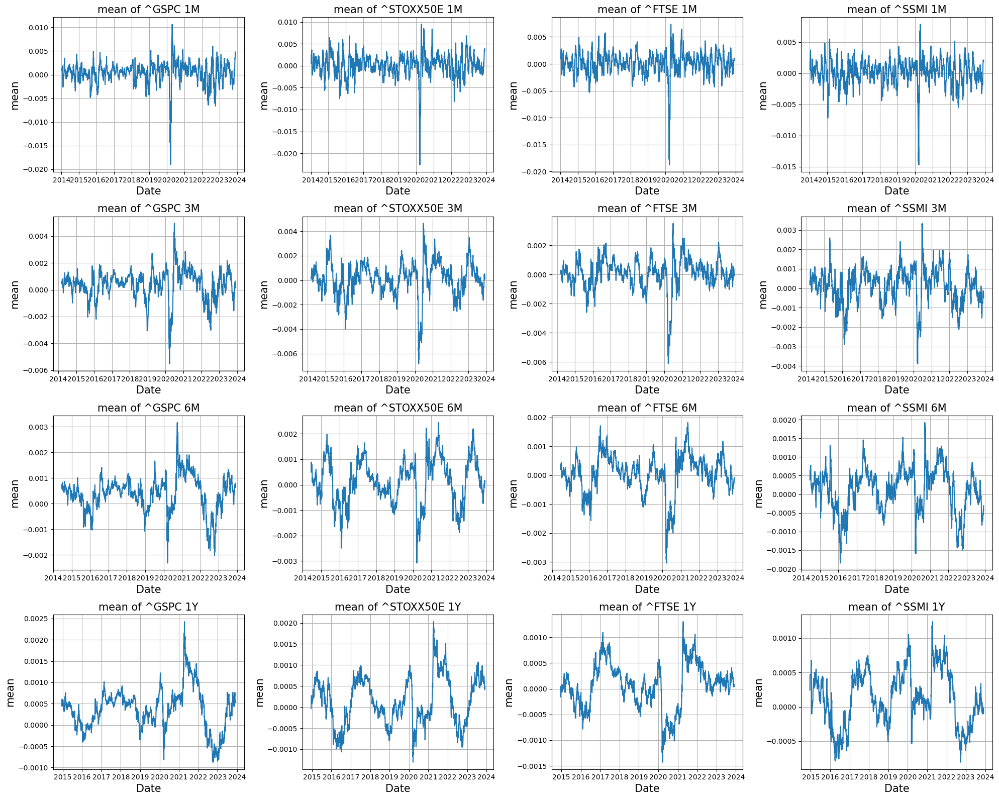

In [158]:
MomentPlot('mean')

### <center>Variance Plots<center>

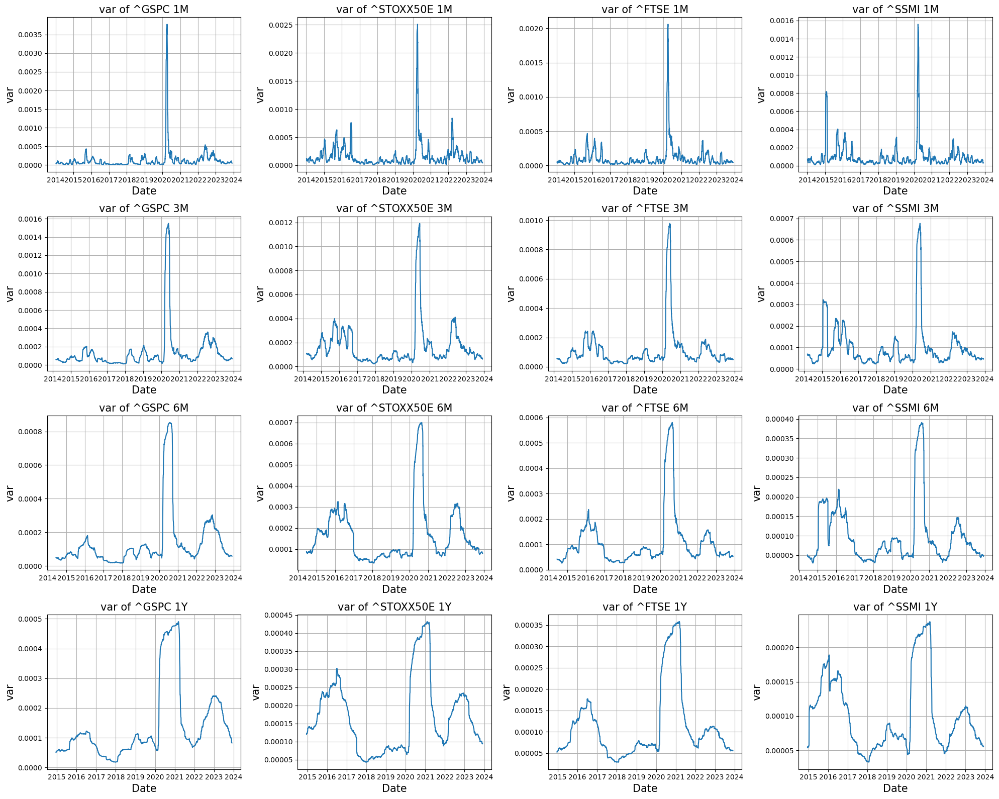

In [159]:
MomentPlot('var')

### <center>Skew Plots<center>

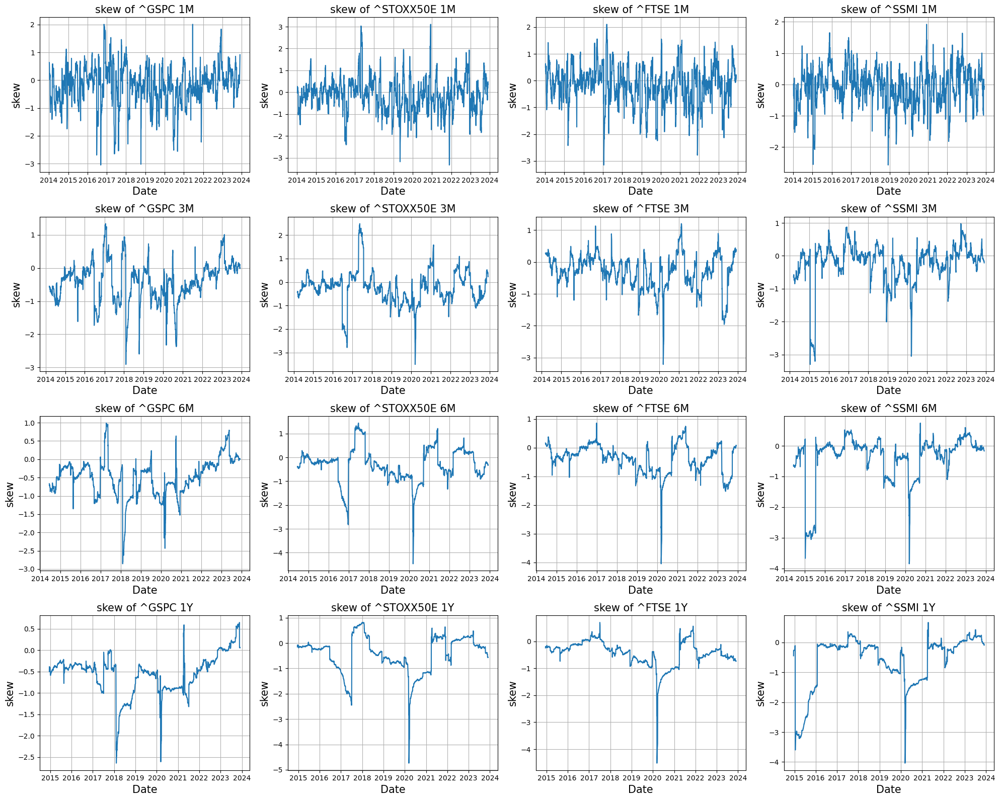

In [160]:
MomentPlot('skew')

### <center>Kurtosis Plots<center>

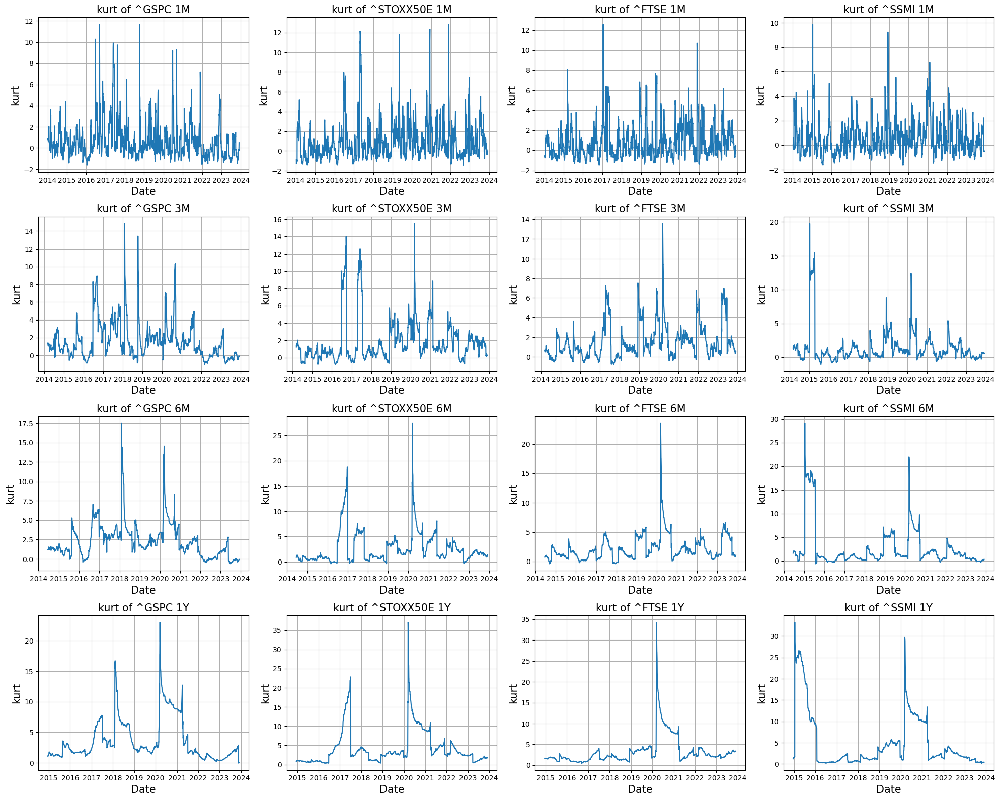

In [161]:
MomentPlot('kurt')

#### <span style="color:blue">(e) What about the distribution of interest rate returns?</span>

### <center>Distribution of Recent Interest Rates' Log Return<center>

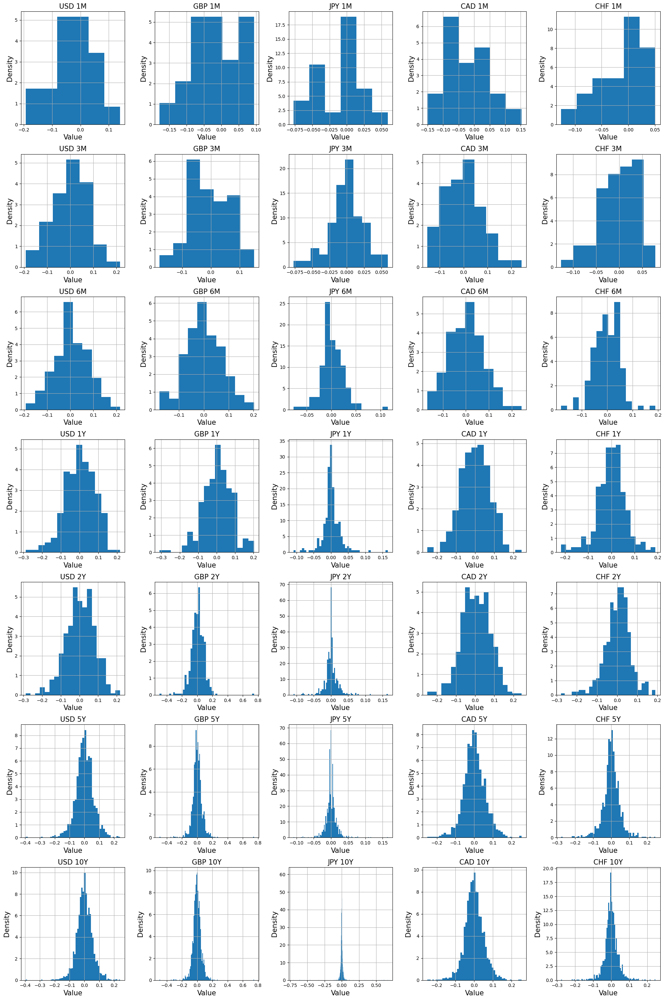

In [326]:
R_Hist(IR, IRs, True)

### Gaussian Distribution

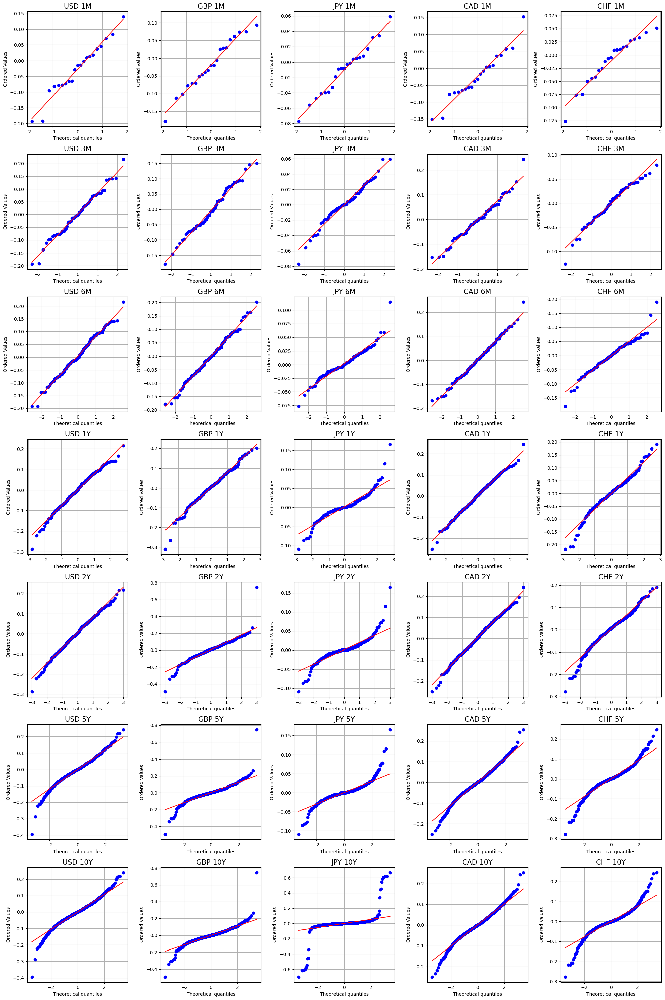

In [95]:
R_norm_qqPlot(IR, IRs, True)

__So, according to the QQPlot, the Interest Rate returns do not follow a Gaussian distribution.__

### Student T (degree of freedom = 5)

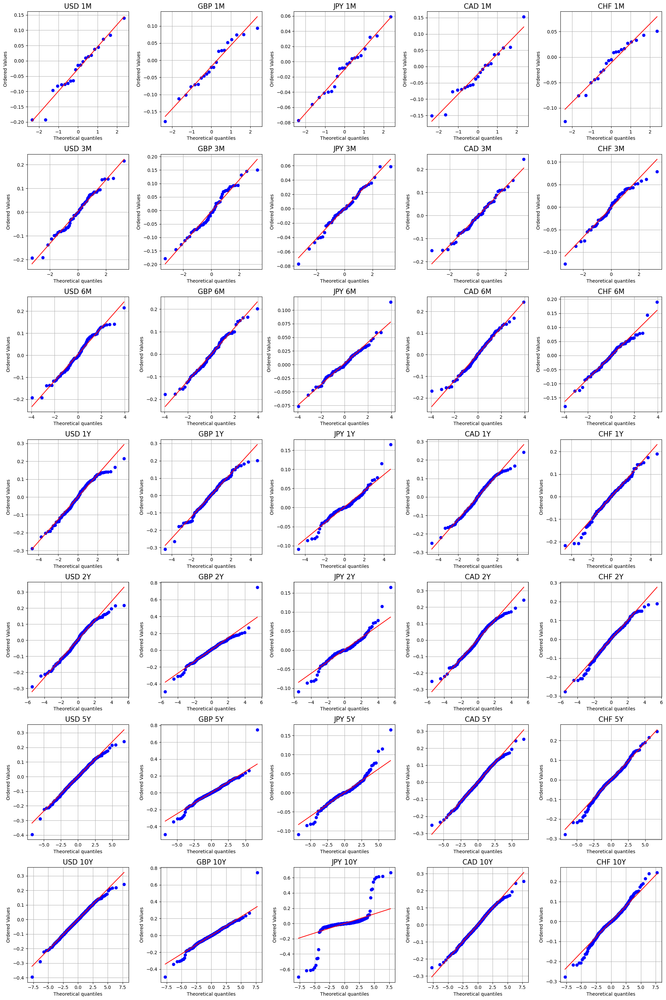

In [109]:
R_t_qqPlot(IR, IRs, True, 5)

__So, according to the QQPlot, Student T distribution (with degree of freedom = 5) fits the Interest Rates returns much better.__

### <span style="color:blue">(f) What about the distribution of currency pairs?</span>

### <center>Distribution of Recent Main Currency Pairs' Log Return<center>

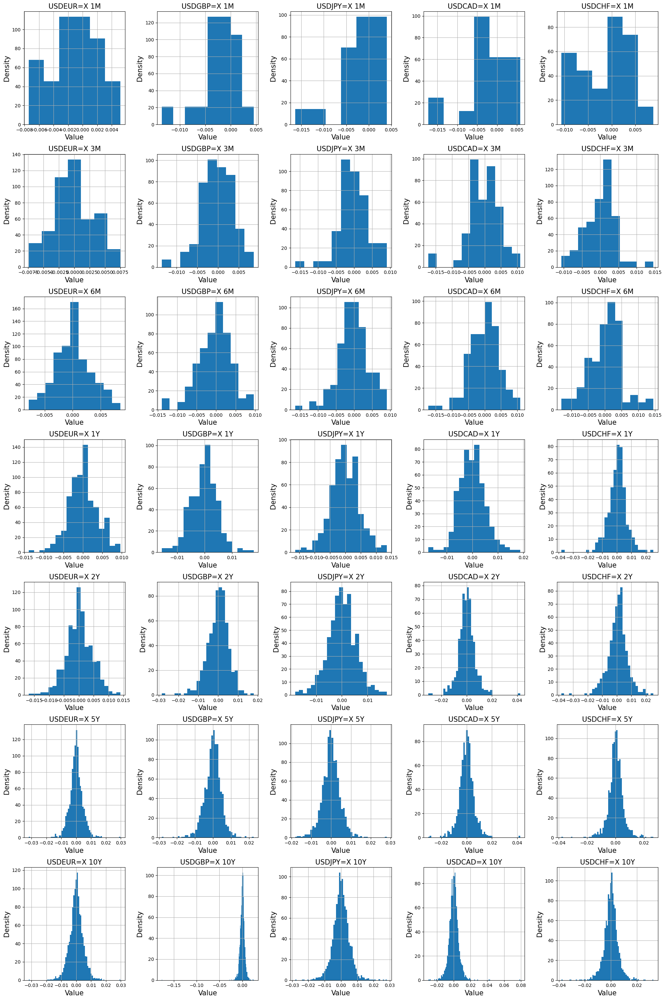

In [323]:
R_Hist(MCP, currency_pairs, False)

### Gaussian Distribution

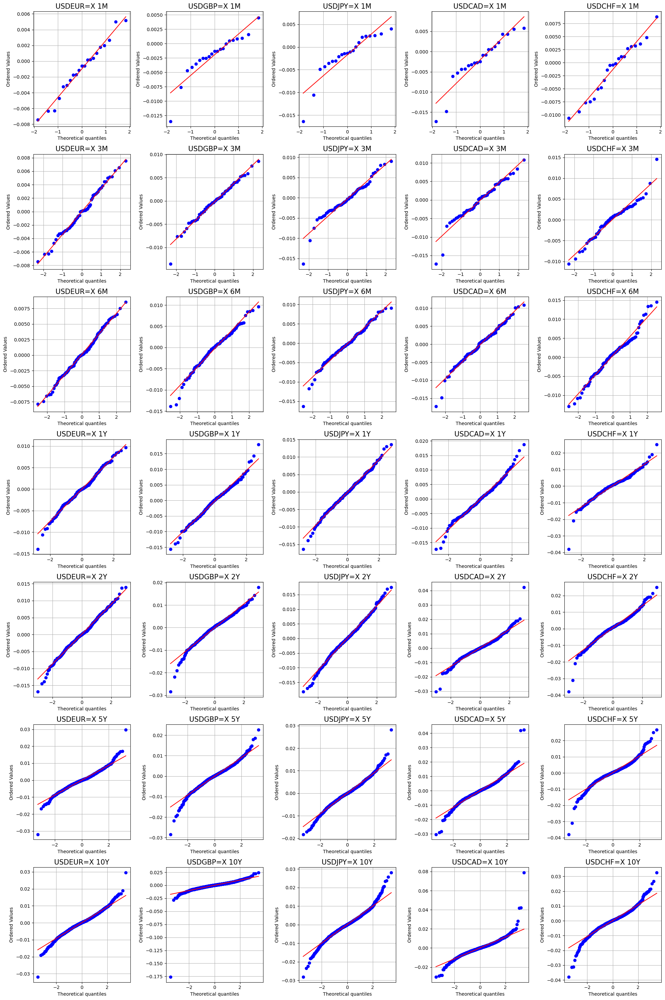

In [111]:
R_norm_qqPlot(MCP, currency_pairs, False)

__So, according to the QQPlot, the Main Currency Pairs returns do not follow a Gaussian distribution.__

### Student T (degree of freedom = 5)

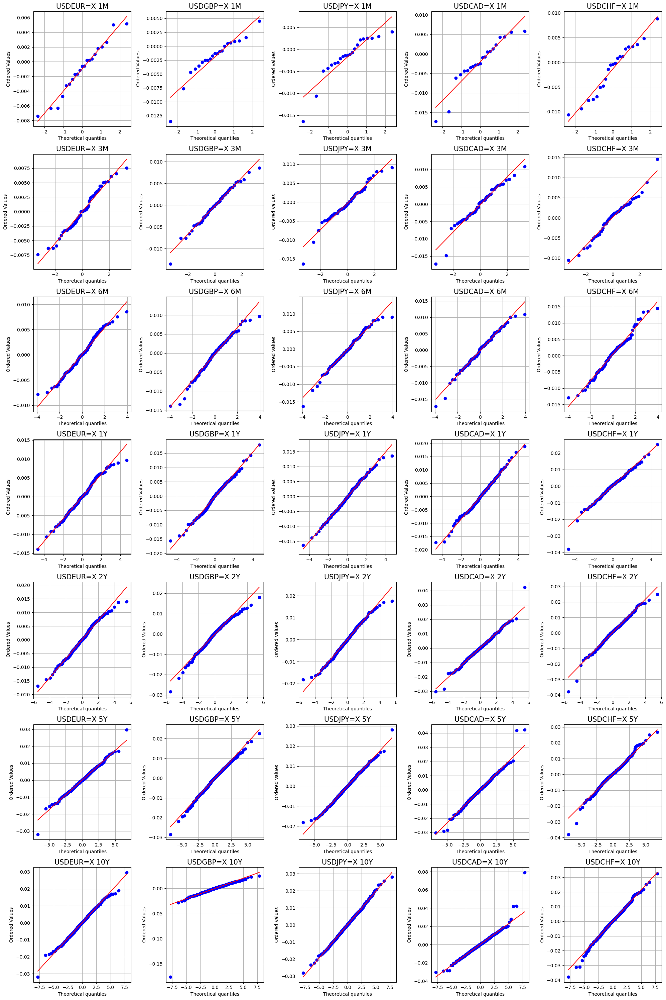

In [113]:
R_t_qqPlot(MCP, currency_pairs, False, 5)

__So, according to the QQPlot, Student T distribution (with degree of freedom = 5) fits the Main Currency Pairs returns much better.__

## <span style="color:blue"><center>4. Underlying and Correlation (20 pts)</span><center>

### <span style="color:blue">(a) For the S&P500 index, perform a linear regression of top 50 market cap component on the S&P index. Show a time series of the R2 and other relevant statistics of your choice as well as time series of the slope (or "beta") for the top 5 underlyings.</span>

### S&P 500

In [31]:
SandP500 = pd.read_excel('S&P500.xlsx')
SP_Comp_tickers = list(SandP500['Ticker'])
SP_Comp = yf.download(SP_Comp_tickers, start='2020-11-30', end='2023-12-01', period='1d')['Adj Close']
SP_Comp = SP_Comp.dropna()
SP_Comp = SP_Comp[SP_Comp_tickers]
SP_Comp

[*********************100%%**********************]  50 of 50 completed


,AAPL,MSFT,GOOG,GOOGL,AMZN,NVDA,META,TSLA,LLY,V,...,DIS,CMCSA,WFC,PFE,VZ,DHR,INTU,QCOM,BA,IBM
Date,,,,,,,,,,,,,,,,,,,,,
2020-11-30,116.983955,208.471268,88.037003,87.720001,158.401993,133.674133,276.970001,189.199997,140.158539,205.861420,...,147.529175,46.706135,25.563194,34.157986,51.042416,196.677826,345.455750,137.173630,210.710007,102.050293
2020-12-01,120.590263,210.555313,89.904999,89.767998,161.003998,133.559433,286.549988,194.919998,140.071945,206.693283,...,148.954544,47.431267,26.226807,35.138771,51.186050,197.001770,350.166290,140.985840,213.009995,101.752884
2020-12-02,120.944008,209.737289,91.397499,91.248497,160.176498,135.100510,287.519989,189.606674,139.687027,205.695038,...,153.110992,47.459156,26.983889,36.378128,51.845097,196.826660,348.861084,140.396057,223.850006,102.959106
2020-12-03,120.806435,208.636841,91.338501,91.092003,159.336502,133.658768,281.850006,197.793335,138.676636,203.610519,...,152.742203,47.961174,27.254940,35.745075,52.166172,195.548325,356.917999,140.330551,237.199997,102.124664
2020-12-04,120.128418,208.753677,91.399498,91.188004,158.128998,135.277634,279.700012,199.679993,142.852997,208.141678,...,153.639267,48.054134,27.619461,35.967983,52.005634,196.502686,361.726562,147.547867,232.710007,105.090660
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-24,189.970001,377.429993,138.220001,136.690002,146.740005,477.718018,338.230011,235.449997,601.099976,254.300003,...,95.747948,42.580002,42.919998,30.500000,37.410000,221.410004,564.070007,126.942665,220.000000,155.179993
2023-11-27,189.789993,378.609985,138.050003,136.410004,147.729996,482.377594,334.700012,236.080002,591.530029,254.139999,...,94.860840,42.090000,43.020000,30.139999,37.349998,220.000000,561.229980,127.389816,219.300003,155.570007
2023-11-28,190.399994,382.700012,138.619995,137.199997,147.029999,478.167938,338.989990,246.720001,591.599976,252.940002,...,92.199516,41.869999,43.369999,29.690001,37.470001,218.759995,565.070007,125.789993,222.369995,155.649994


In [32]:
SP_All = pd.merge(SP_Comp, Indices['^GSPC'], on='Date', how='inner')
SP_All

,AAPL,MSFT,GOOG,GOOGL,AMZN,NVDA,META,TSLA,LLY,V,...,CMCSA,WFC,PFE,VZ,DHR,INTU,QCOM,BA,IBM,^GSPC
Date,,,,,,,,,,,,,,,,,,,,,
2020-11-30,116.983955,208.471268,88.037003,87.720001,158.401993,133.674133,276.970001,189.199997,140.158539,205.861420,...,46.706135,25.563194,34.157986,51.042416,196.677826,345.455750,137.173630,210.710007,102.050293,3621.629883
2020-12-01,120.590263,210.555313,89.904999,89.767998,161.003998,133.559433,286.549988,194.919998,140.071945,206.693283,...,47.431267,26.226807,35.138771,51.186050,197.001770,350.166290,140.985840,213.009995,101.752884,3662.449951
2020-12-02,120.944008,209.737289,91.397499,91.248497,160.176498,135.100510,287.519989,189.606674,139.687027,205.695038,...,47.459156,26.983889,36.378128,51.845097,196.826660,348.861084,140.396057,223.850006,102.959106,3669.010010
2020-12-03,120.806435,208.636841,91.338501,91.092003,159.336502,133.658768,281.850006,197.793335,138.676636,203.610519,...,47.961174,27.254940,35.745075,52.166172,195.548325,356.917999,140.330551,237.199997,102.124664,3666.719971
2020-12-04,120.128418,208.753677,91.399498,91.188004,158.128998,135.277634,279.700012,199.679993,142.852997,208.141678,...,48.054134,27.619461,35.967983,52.005634,196.502686,361.726562,147.547867,232.710007,105.090660,3699.120117
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-24,189.970001,377.429993,138.220001,136.690002,146.740005,477.718018,338.230011,235.449997,601.099976,254.300003,...,42.580002,42.919998,30.500000,37.410000,221.410004,564.070007,126.942665,220.000000,155.179993,4559.339844
2023-11-27,189.789993,378.609985,138.050003,136.410004,147.729996,482.377594,334.700012,236.080002,591.530029,254.139999,...,42.090000,43.020000,30.139999,37.349998,220.000000,561.229980,127.389816,219.300003,155.570007,4550.430176
2023-11-28,190.399994,382.700012,138.619995,137.199997,147.029999,478.167938,338.989990,246.720001,591.599976,252.940002,...,41.869999,43.369999,29.690001,37.470001,218.759995,565.070007,125.789993,222.369995,155.649994,4554.890137


In [33]:
import statsmodels.api as sm

Example of a regression:

In [34]:
SP_Comp_with_intercept = sm.add_constant(SP_All.iloc[:, :-1])

SP_model = sm.OLS(SP_All['^GSPC'], SP_Comp_with_intercept)
SP_results = SP_model.fit()

SP_r_squared = SP_results.rsquared
SP_f_p_value = SP_results.f_pvalue 
SP_Top5_betas = SP_results.params[1:6]   

print("R^2:", SP_r_squared)
print("P-Value:", SP_f_p_value)
print("Betas (Regression Coefficients):", SP_Top5_betas)

R^2: 0.9984542773648135
P-Value: 0.0
Betas (Regression Coefficients): AAPL     1.551265
MSFT     1.300869
GOOG     7.667517
GOOGL   -6.765219
AMZN     1.255404
dtype: float64


In [35]:
print(SP_results.summary())

                            OLS Regression Results                            
Dep. Variable:                  ^GSPC   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     8630.
Date:                Wed, 20 Dec 2023   Prob (F-statistic):               0.00
Time:                        21:31:38   Log-Likelihood:                -2757.7
No. Observations:                 719   AIC:                             5617.
Df Residuals:                     668   BIC:                             5851.
Df Model:                          50                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -56.3875     29.694     -1.899      0.0

In [38]:
def rollingOLS(df_comp, index_name, window):
    
    R2_rolling = []
    f_pvalue_rolling = []
    fstat_rolling = []
    beta1_rolling = []
    beta2_rolling = []
    beta3_rolling = []
    beta4_rolling = []
    beta5_rolling = []
    
    df_All = pd.merge(df_comp, Indices[index_name], on='Date', how='inner')
    df_All = df_All.dropna()
    
    y = df_All[index_name]
    X = df_All.iloc[:, :-1]
    
    for i in range(len(df_All)-window+1):

        window_X = X.iloc[i:i+window]
        window_y = y.iloc[i:i+window]

        window_X_with_intercept = sm.add_constant(window_X)

        model = sm.OLS(window_y, window_X_with_intercept)
        results = model.fit()
        
        R2_rolling.append(results.rsquared)
        f_pvalue_rolling.append(results.f_pvalue)
        fstat_rolling.append(results.fvalue)
        beta1_rolling.append(results.params[1])
        beta2_rolling.append(results.params[2])
        beta3_rolling.append(results.params[3])
        beta4_rolling.append(results.params[4])
        beta5_rolling.append(results.params[5])
        
        
    return(R2_rolling, beta1_rolling, beta2_rolling, beta3_rolling, beta4_rolling, beta5_rolling, f_pvalue_rolling, fstat_rolling,)

In [53]:
def OLSPlot(df_comp, index_name, tenors):
    %matplotlib inline
    fig, axes = plt.subplots(nrows=6, ncols=4, figsize=(30, 28)) #, sharex=True, sharey=True

    k = 0
    
    for j in range(4):
        window = tenors[j]
            # j is time window
        for i in range(6):
            # i is param: r2 -> betas
        
            ax = axes[i,j]
            params_in_plot = ['R Squared','Beta 1','Beta 2','Beta 3','Beta 4','Beta 5']
            ax.set_title("{} Regression {} {}".format(index_name, rolling_tenors[j], params_in_plot[i]), fontsize = 15)
            ax.set_xlabel("Day", fontsize = 15)
            ax.set_ylabel("Value", fontsize = 15)
            y = rollingOLS(df_comp, index_name, window)[i]
            #y.index = pd.DataFrame(result_r).set_index(data_tmp.index[days-1:])
            ax.plot(y)
            ax.grid(True)
            k += 1

    #fig.suptitle("Mean Plots", fontsize=30)

    plt.tight_layout()
    plt.show()

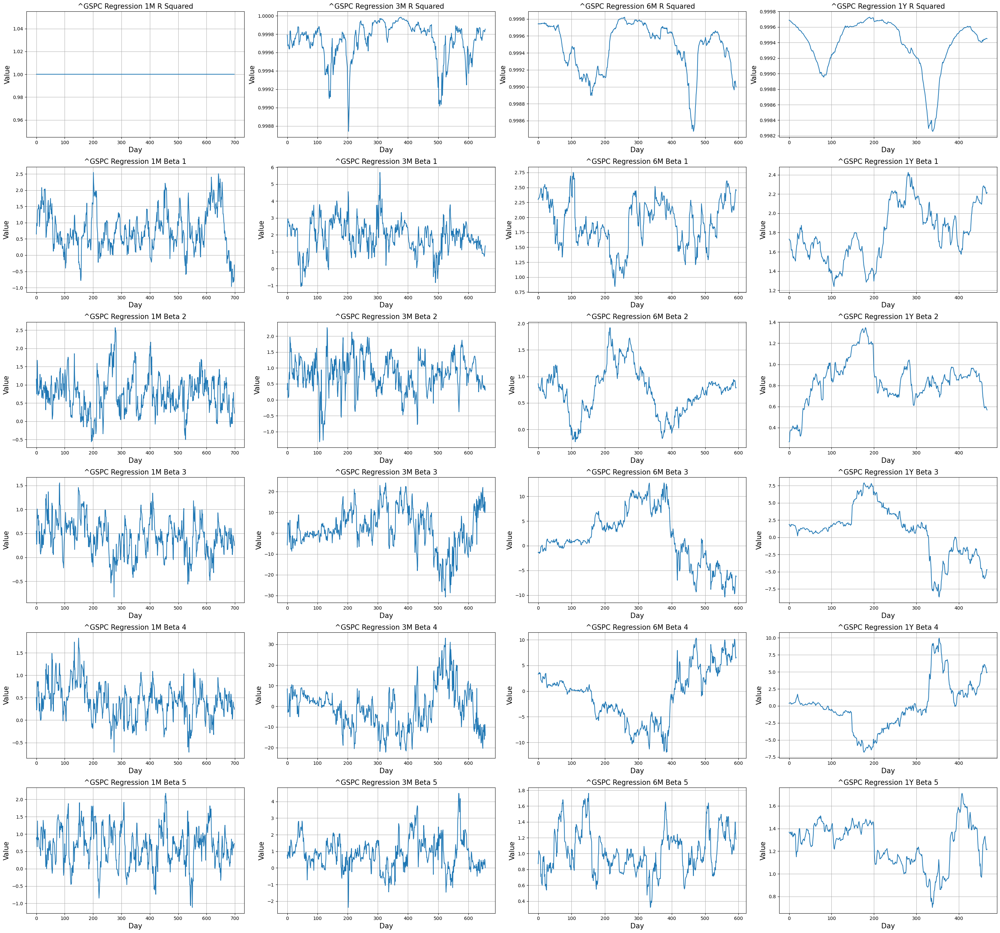

In [54]:
OLSPlot(SP_Comp, '^GSPC', rolling_tenors_int)

### <span style="color:blue">(b) Select 3 other major indices of your choice, perform the same analysis. If the index has 50 or less components, try to use all the single stocks data.</span>

### EUROSTOXX 50

In [332]:
EUROSTOXX50 = pd.read_csv('EUROSTOXX50.csv')
EU_Comp_tickers = list(EUROSTOXX50['TICKERS'])
EU_Comp = yf.download(EU_Comp_tickers, start='2020-11-30', end='2023-12-01', period='1d')['Adj Close']
EU_Comp = EU_Comp.dropna()
EU_Comp = EU_Comp[EU_Comp_tickers]
EU_Comp

[*********************100%%**********************]  48 of 48 completed


,MC.PA,ASML.AS,OR.PA,RMS.PA,SAP.DE,TTE.PA,SIE.DE,ITX.MC,ABI.BR,DTE.DE,...,BN.PA,ADYEN.AS,ADS.DE,DB1.DE,BAYN.DE,AD.AS,FLTR.L,VNA.DE,KNEBV.HE,PHIA.AS
Date,,,,,,,,,,,,,,,,,,,,,
2020-11-30,459.894348,353.933868,294.768250,803.016602,98.083672,29.508619,103.082985,25.625542,53.681988,13.630648,...,48.622684,1602.000000,258.577728,131.235947,43.205418,21.645226,13705.0,51.216522,66.857826,41.054314
2020-12-01,475.051971,362.688599,294.287872,807.928650,97.352707,29.924583,103.948151,25.607140,54.181534,13.644176,...,47.683815,1596.000000,263.898254,129.827301,43.567928,21.428684,13535.0,50.539337,65.374649,41.276817
2020-12-02,476.103912,360.986298,294.383942,812.644226,97.429649,30.237583,103.929741,25.689951,53.912552,13.653194,...,47.124107,1621.500000,259.061401,131.001160,42.807110,21.221165,13365.0,49.986893,65.146454,40.675579
2020-12-03,476.247406,362.980408,293.038849,825.022461,97.044930,30.035784,103.009354,25.441519,54.709900,13.563014,...,46.329674,1652.500000,264.865631,129.545593,42.735504,21.121914,14300.0,50.040359,65.013344,40.637711
2020-12-04,470.748596,367.990051,294.287872,811.858276,98.853096,31.044792,104.279488,25.524328,55.747417,13.716319,...,46.564396,1659.000000,266.316681,128.230896,42.766830,20.670782,14800.0,49.701763,63.549168,40.822342
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-24,701.339417,632.299988,431.450012,1951.199951,141.080002,63.139999,150.860001,37.259998,57.720001,21.900000,...,59.119999,1073.599976,184.440002,173.000000,32.645000,26.895000,12620.0,25.120001,42.049999,19.590000
2023-11-27,691.814941,628.599976,432.950012,1951.000000,141.600006,62.860001,150.240005,37.139999,57.200001,21.955000,...,59.080002,1090.400024,185.240005,173.399994,31.660000,26.705000,12420.0,25.379999,41.779999,19.690001
2023-11-28,679.115601,619.700012,430.700012,1911.800049,142.539993,63.189999,151.419998,37.220001,57.270000,21.875000,...,59.049999,1088.800049,186.660004,172.949997,30.555000,26.480000,12525.0,25.340000,41.389999,19.544001


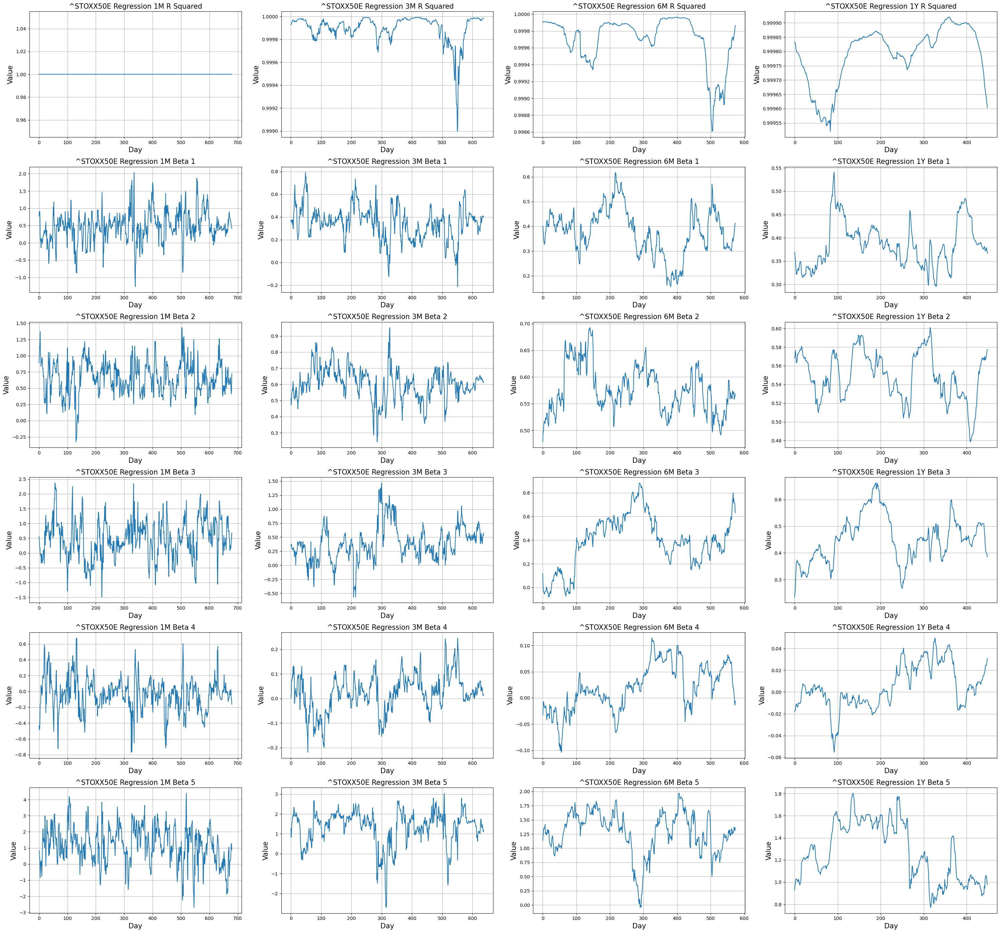

In [333]:
OLSPlot(EU_Comp, '^STOXX50E', rolling_tenors_int)

### FTSE

In [334]:
FTSE = pd.read_excel('FTSE.xlsx')
FTSE_Comp_tickers = list(FTSE['TICKER'])
FTSE_Comp = yf.download(FTSE_Comp_tickers, start='2020-11-30', end='2023-12-01', period='1d')['Adj Close']
FTSE_Comp = FTSE_Comp.dropna()
FTSE_Comp = FTSE_Comp[FTSE_Comp_tickers]
FTSE_Comp

[*********************100%%**********************]  50 of 50 completed


,BC94.L,SHEL.L,AZN.L,BHP.L,HSBA.L,RIO.L,ULVR.L,BP.L,DGE.L,GSK.L,...,SGE.L,AV.L,IHG.L,INF.L,RTO.L,SMT.L,BNZL.L,SGRO.L,NXT.L,SN.L
Date,,,,,,,,,,,,,,,,,,,,,
2020-11-30,1518.783569,1132.314209,7266.512207,1301.500732,331.162628,4179.716797,4092.338135,215.721085,2695.139893,1175.974487,...,560.635803,277.939148,4450.959961,518.345947,477.710388,1087.942505,2199.854980,843.165161,5960.197754,1343.957886
2020-12-01,1544.000000,1161.708862,7261.857910,1346.247925,346.387970,4321.085938,3969.684570,222.167038,2738.655273,1185.416626,...,544.882263,287.630768,4556.410645,536.921204,472.715271,1097.869019,2200.787598,845.199158,6136.674805,1396.289795
2020-12-02,1581.000000,1205.889893,7389.405273,1422.256836,356.836761,4529.899414,3938.350586,232.707001,2735.847656,1196.232300,...,536.171631,290.832428,4556.410645,536.530090,477.614380,1088.935303,2207.315186,839.651917,6147.590820,1389.343018
2020-12-03,1590.000000,1208.205566,7195.756348,1454.131470,359.395691,4652.679199,3834.497314,232.140823,2709.177246,1180.094727,...,541.916992,289.793976,4677.199219,547.088623,479.535614,1093.898438,2192.106689,850.561279,6171.242188,1381.470215
2020-12-04,1643.397949,1249.180054,7408.956055,1479.110352,360.504517,4712.340820,3872.994629,241.243530,2744.269775,1189.708374,...,531.723633,292.649597,4772.103516,560.384644,475.597107,1092.905762,2192.106689,836.323669,6163.964844,1410.182983
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-24,1368.000000,2595.000000,10180.000000,2460.500000,609.500000,5486.000000,3800.000000,476.500000,2824.000000,1422.599976,...,1104.000000,424.700012,6150.000000,746.400024,455.000000,713.000000,2973.000000,808.799988,7730.681152,1024.500000
2023-11-27,1363.000000,2570.500000,9976.000000,2437.000000,607.400024,5462.000000,3801.500000,475.049988,2808.500000,1414.199951,...,1119.000000,428.200012,6148.000000,746.400024,448.700012,712.200012,2976.000000,819.000000,7760.437500,1021.500000
2023-11-28,1396.000000,2580.500000,9900.000000,2426.500000,607.200012,5432.000000,3786.000000,475.000000,2774.500000,1411.800049,...,1131.500000,424.600006,6124.000000,741.799988,442.700012,712.799988,2975.000000,808.599976,7835.819824,1021.000000


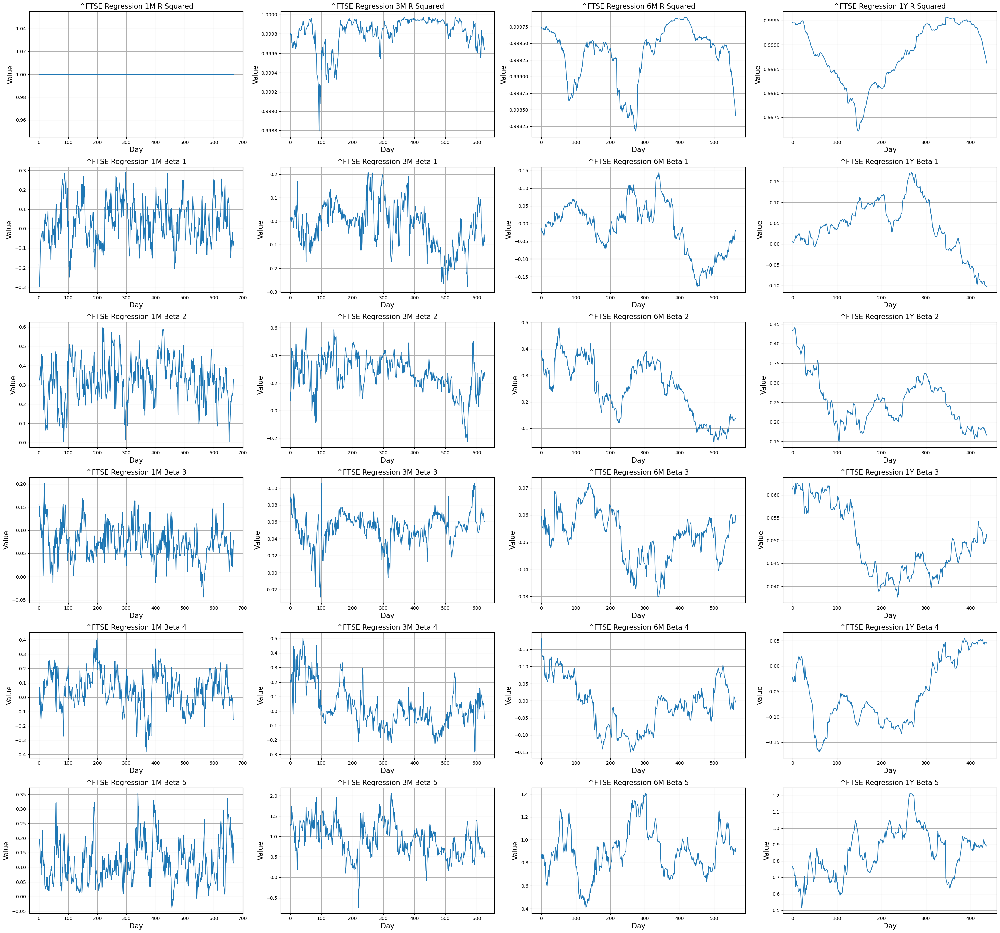

In [335]:
OLSPlot(FTSE_Comp, '^FTSE', rolling_tenors_int)

### SMI

In [336]:
SMI = pd.read_excel('SMI.xlsx')
SMI_Comp_tickers = list(SMI['ticker'])
SMI_Comp = yf.download(SMI_Comp_tickers, start='2020-11-30', end='2023-12-01', period='1d')['Adj Close']
SMI_Comp = SMI_Comp.dropna()
SMI_Comp = SMI_Comp[SMI_Comp_tickers]
SMI_Comp

[*********************100%%**********************]  20 of 20 completed


,ABBN.SW,ALC.SW,GEBN.SW,GIVN.SW,HOLN.SW,KNIN.SW,LOGN.SW,LONN.SW,NESN.SW,NOVN.SW,PGHN.SW,CFR.SW,ROG.SW,SIKA.SW,SOON.SW,SLHN.SW,SREN.SW,SCMN.SW,UBSG.SW,ZURN.SW
Date,,,,,,,,,,,,,,,,,,,,
2020-11-30,22.073246,57.298519,511.750183,3494.044922,42.058784,185.094788,76.571251,560.135071,93.957001,72.753860,883.647644,72.565186,272.632050,224.846130,215.297531,351.952271,67.561806,424.803223,11.852868,316.132538
2020-12-01,22.192961,57.535698,506.698181,3435.559082,42.791241,181.405487,75.580536,543.810913,93.269829,71.957970,874.584595,72.084488,273.133514,224.167404,216.827850,360.451843,68.440704,424.803223,11.958614,319.817474
2020-12-02,21.999577,56.270741,493.039032,3399.713135,42.614746,176.411423,74.323082,543.024292,92.879799,72.444344,877.122192,71.642250,275.914062,221.161728,213.671555,357.589752,67.903603,423.918213,11.852868,319.817474
2020-12-03,22.091663,55.045319,491.729218,3349.717529,42.561798,175.736557,73.484772,530.830261,92.220490,71.560005,887.635437,71.373062,273.224670,216.798615,213.288971,354.033844,67.496696,421.351715,11.894247,312.790375
2020-12-04,22.137709,55.934734,491.167908,3340.284180,42.870663,174.746735,73.389519,534.960449,91.932625,71.807625,884.735229,71.046188,275.549377,216.410767,213.767212,354.727631,67.708282,420.820679,11.843672,311.933411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-24,34.130001,64.660004,482.600006,3254.000000,63.060001,252.899994,74.519997,350.500000,100.480003,86.790001,1146.000000,112.099998,238.699997,237.300003,250.300003,563.599976,102.650002,515.799988,23.309999,435.799988
2023-11-27,33.889999,64.720001,479.000000,3265.000000,62.900002,254.399994,74.720001,344.799988,100.220001,85.970001,1132.500000,111.699997,236.899994,235.000000,253.500000,563.000000,103.050003,514.599976,23.010000,435.799988
2023-11-28,33.880001,64.800003,478.200012,3236.000000,63.180000,253.399994,74.540001,339.000000,99.400002,85.279999,1129.000000,108.500000,235.899994,235.000000,246.199997,559.599976,103.300003,513.000000,23.200001,434.899994


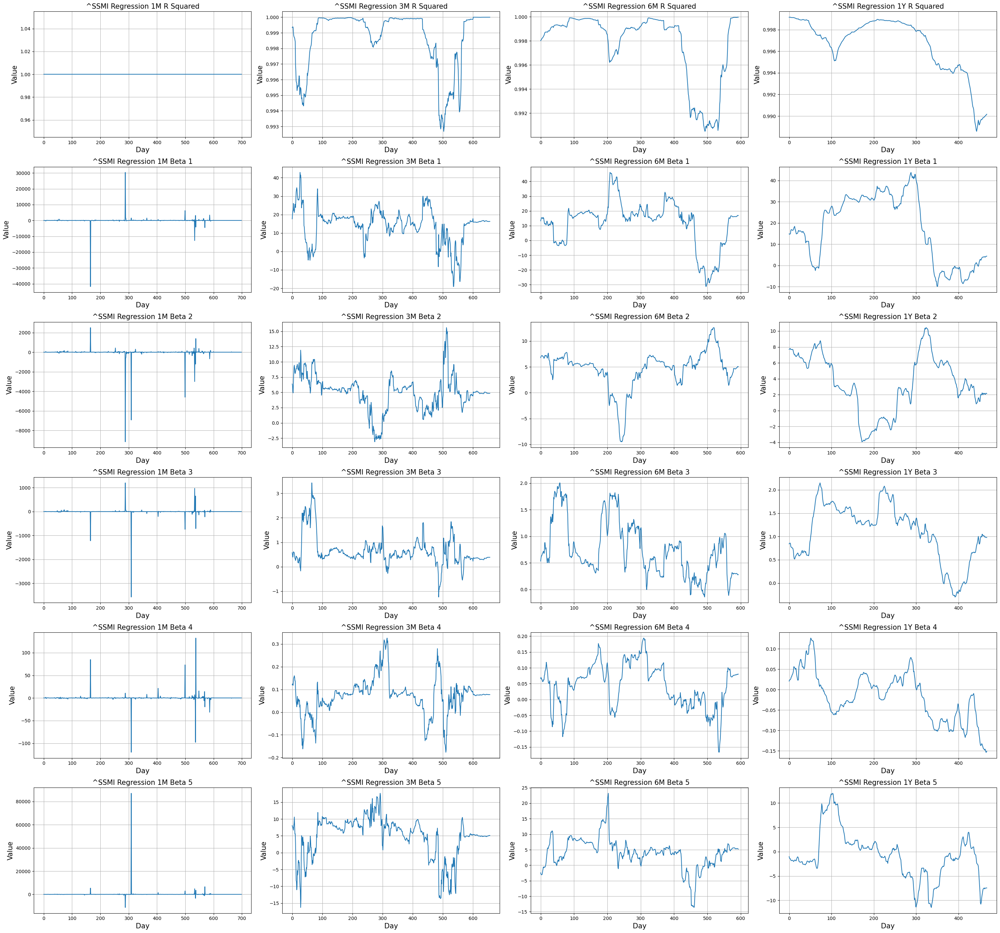

In [337]:
OLSPlot(SMI_Comp, '^SSMI', rolling_tenors_int)

### <span style="color:blue">(c) In each case, comment on the results you obtain.</span>

__1) Note that the first graph shows that the $R^2$ of 1M rolling is equal to 1. This is because there are 21 observations and 50 factors, so no wonder there are multiple solutions and there is no meaning of the regression. Same for the other 3 indices below.__

__2) Every regression has a $R^2$ really close to 1 and an extremely small fp-value, and every $\beta$ has extremely small p-value, showing that the regression and factors are significant under a significance level of 1% (even less than 1%). This makes sense because the indices are compiled from these stocks, so it is obvious that Top-5-market-cap enterprises have a large impact on them.__

__3) As the window size of rolling becomes longer, the volatility of parameters become smaller.__

__4) For S&P500, APPLE, MSFT, and AMZN nearly have positive $\beta$ all the time, showing that they have a large positive impact on S&P500. Besides, the $\beta$ of GOOG and GOOGL are nearly opposite from each other (the lines are symmetric about x-axis). This may due to they are from the same company Google and therefore have a strong multicollinearility.__

__5) For EUROSTOXX 50, MC.PA, ASML.AS, OR.PA, and SAP.DE all have positive $\beta$ all the time, but RMS.PA's $\beta$ is positive for 50% of the time and negative for 50%.__

__6) For FTSE 100, HSBA.L has a very large $\beta$; the second largest is SHEL.L; AZN.L has small positive $\beta$; BC94.L's $\beta$ is increasing first and then decreasing to the negative; BHP.L's $\beta$ is for the most of the time negative.__

__7) For SMI, the top-1-market-cap enterprise wth stock ABBN.SW has highest $\beta$, which value is in dozen; ALC.SW and HOLN.SW has second largest $\beta$, then GEBN.SW, and smallest impact is GIVN.SW. Noticeablly, all of them have negative $\beta$ for some time.__

## <span style="color:blue"><center>5. Volatility Distribution (25 pts)</span><center>

### <span style="color:blue">(a) For the S&P 500 and 3 major index of your choice, compute histogram of the historical distribution of their realized volatility (therefore, you need to compute volatility of the returns itself).</span>

I use the fomula derived in our HW2:

$$\sigma = \sqrt{\frac{252}{n} \sum_{i=1}^{n} (X_{t_{i}} −X_{t_{i−1}})^2}$$

where $X$ is log value of price for indices and main currency pairs, and is just the original value for interest rates, as specified in our Project description.

In [89]:
def rea_vol(df, window_len, isIR):
    
    if not isIR:
        Log_df = np.log(df)
        R_df = Log_df.diff()
    else:
        R_df = df.diff()
    
    R_df = R_df.dropna()
    
    # Initialize the historical volatility dataframe
    rea_vol = R_df.copy()
    rea_vol.loc[:, :] = None
    rea_vol = rea_vol.iloc[window_len:]

    for i in range(len(rea_vol)):
        # roll and use the sigma fomula
        column_sum_of_squares = (R_df.iloc[0+i:window_len+i] ** 2).sum()
        rea_vol.iloc[i]= np.sqrt(252/window_len*column_sum_of_squares)
    
    return rea_vol

In [171]:
def VolType(dff,i,whichVol,isIR):
    if whichVol == 'ReaVol':
        y = dff.iloc[:,i]
    elif whichVol == 'ReaVar':
        y = dff.iloc[:,i]**2
    else:
        if not isIR:
            y = np.diff(np.log(dff.iloc[:,i].astype(float)))
        else:
            y = np.diff(dff.iloc[:,i].astype(float))
    return y

In [175]:
def VolPlot(df, tickers_list, isIR, whichVol):
    
    %matplotlib inline
    fig, axes = plt.subplots(nrows=len(tickers_list), ncols=len(rolling_tenors), figsize=(30, 30)) #, sharex=True, sharey=True
    
    for j in range(len(rolling_tenors)):
        # time
        rea_vol_df = rea_vol(df, rolling_tenors_int[j], isIR)
        
        for i in range(len(tickers_list)):
            # name
            ax = axes[i,j]
            ax.set_title("Vol of {} {}".format(tickers_list[i], rolling_tenors[j]), fontsize = 15)
            ax.set_xlabel("Value", fontsize = 15)
            ax.set_ylabel("Density", fontsize = 15)
            y = VolType(dff,i,whichVol,isIR)
            ax.hist(y, density=True, bins='auto', histtype='stepfilled')
            ax.grid(True)

    #fig.suptitle("Mean Plots", fontsize=30)

    plt.tight_layout()
    plt.show()

### <center>Realized Volatility Histogram of Indices<center>

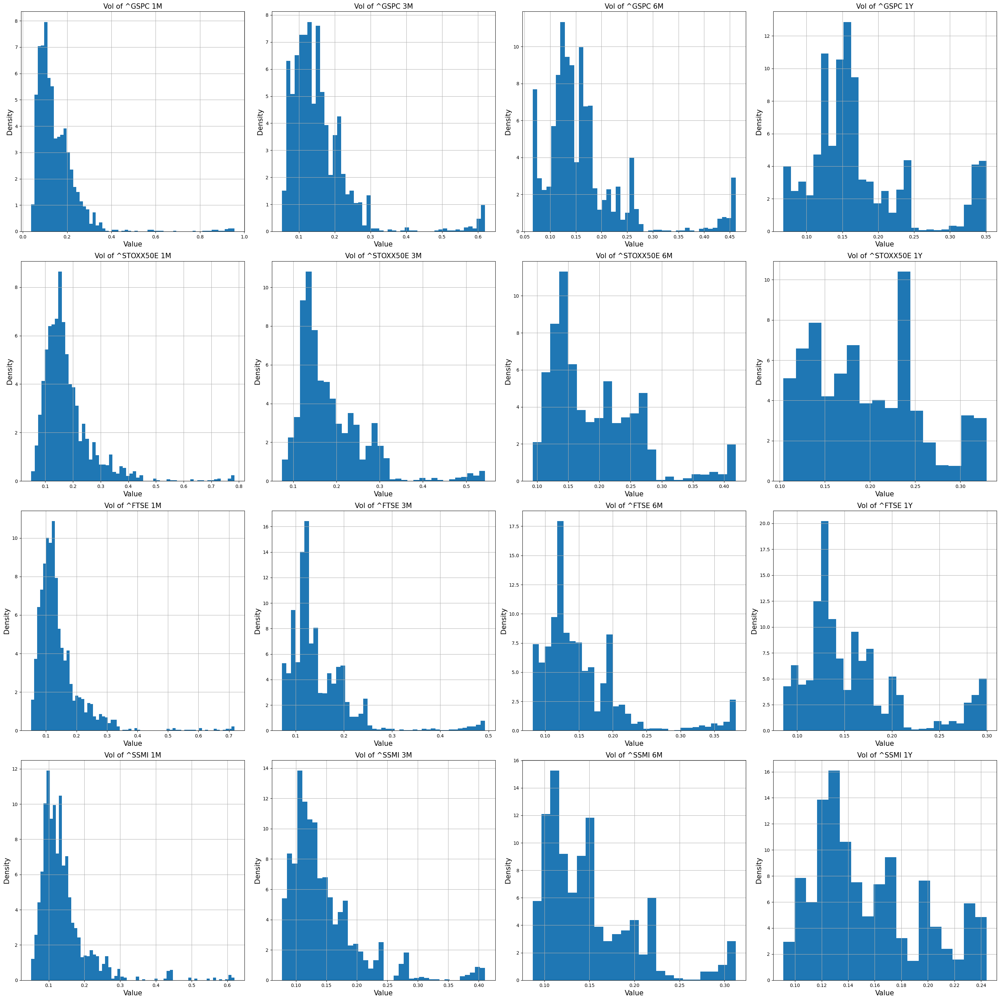

In [173]:
VolPlot(Indices,symbols,False,'ReaVol')

### <span style="color:blue">(b) What about the distribution of variance?</span>

### <center>Realized Variance Histogram of Indices<center>

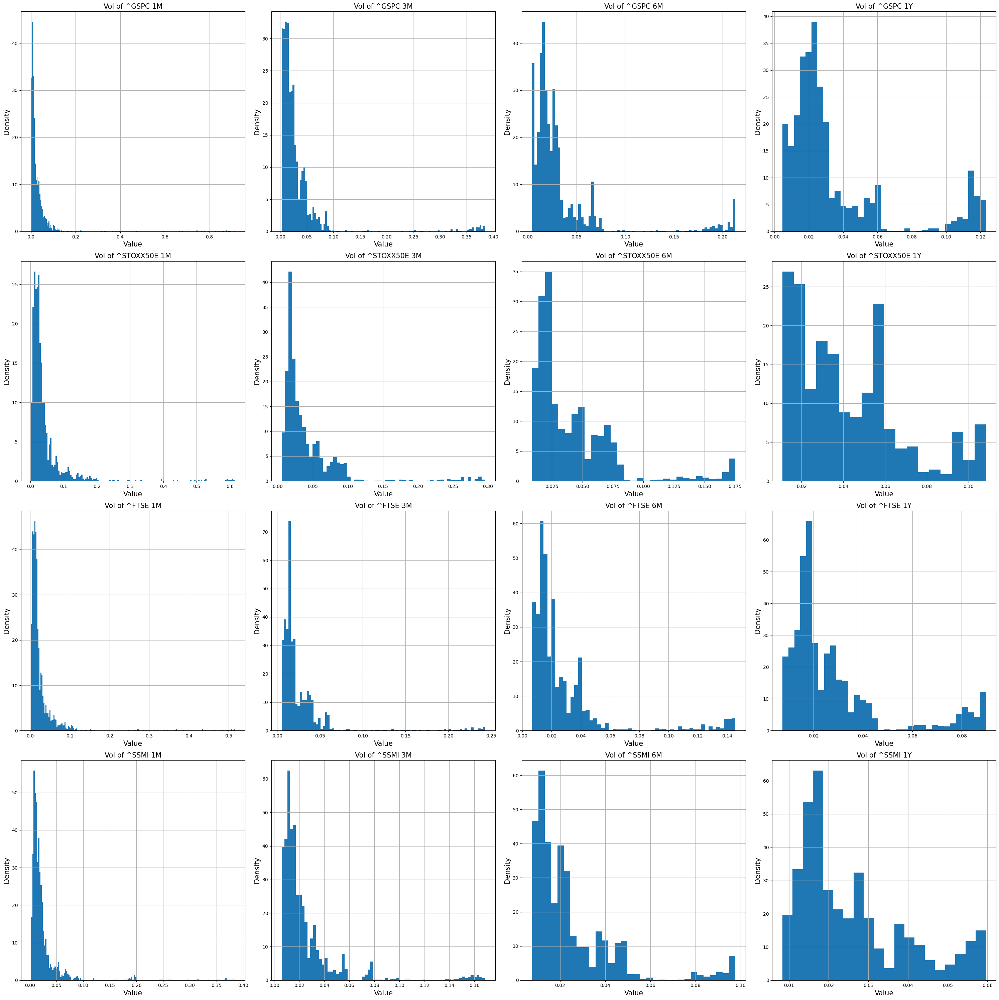

In [131]:
VolPlot(Indices,symbols,False,'ReaVar')

### <span style="color:blue">(c) Draw histograms of the distribution of the log-volatility of the absolute return . Is it Normally distributed?</span>

### <center>Log Volatility Histogram of Indices<center>

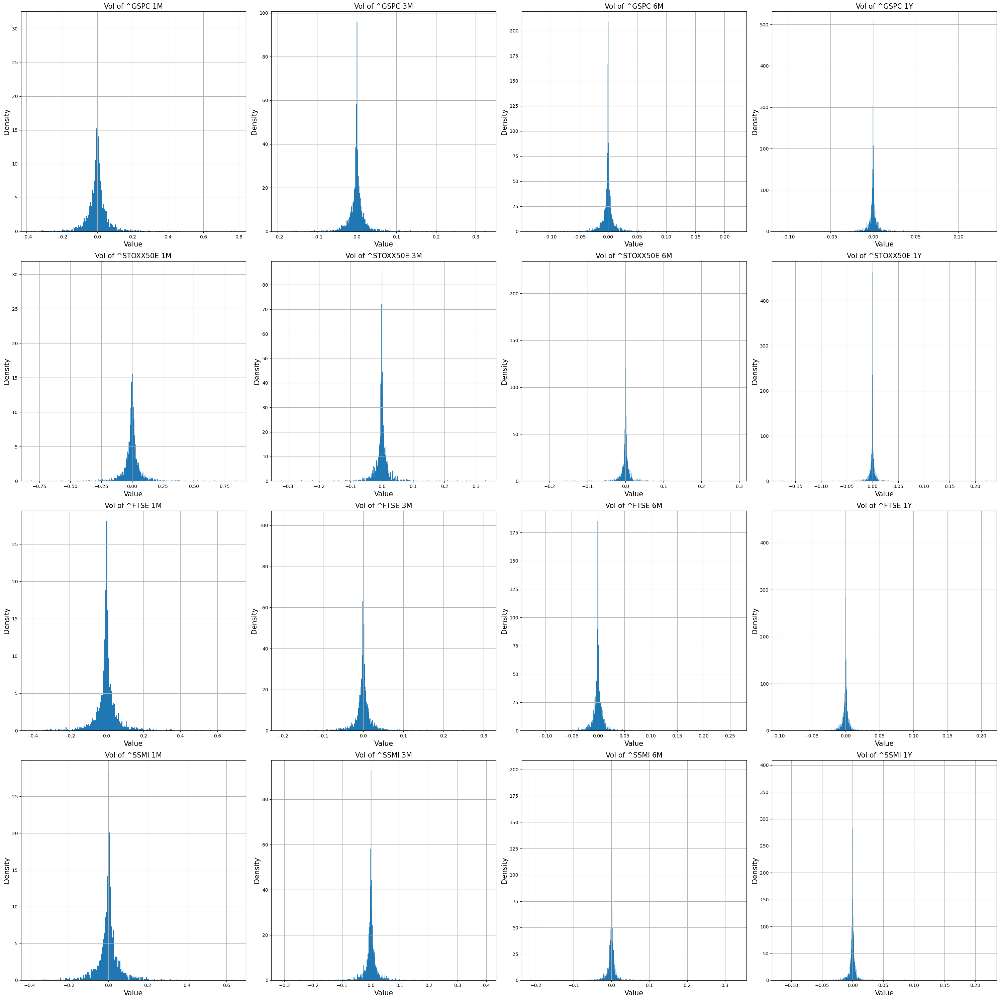

In [154]:
VolPlot(Indices,symbols,False,'LogVol')

### <center>Log Volatility QQPlot of Indices<center>

In [183]:
def Vol_norm_qqPlot(df, tickers_list, isIR, whichVol):
    
    %matplotlib inline
    fig, axes = plt.subplots(nrows=len(tickers_list), ncols=len(rolling_tenors), figsize=(25, 23)) #, sharex=True, sharey=True
    
    for j in range(len(rolling_tenors)):
        # time
        rea_vol_df = rea_vol(df, rolling_tenors_int[j], isIR)
        
        for i in range(len(tickers_list)):
            # name
            ax = axes[i,j]
            ax.set_title("{} {}".format(tickers_list[i], rolling_tenors[j]), fontsize = 15)
            y = VolType(rea_vol_df,i,whichVol,isIR)
            probplot(y, dist='norm', plot=ax)
            ax.grid(True)

    #fig.suptitle("Mean Plots", fontsize=30)

    plt.tight_layout()
    plt.show()

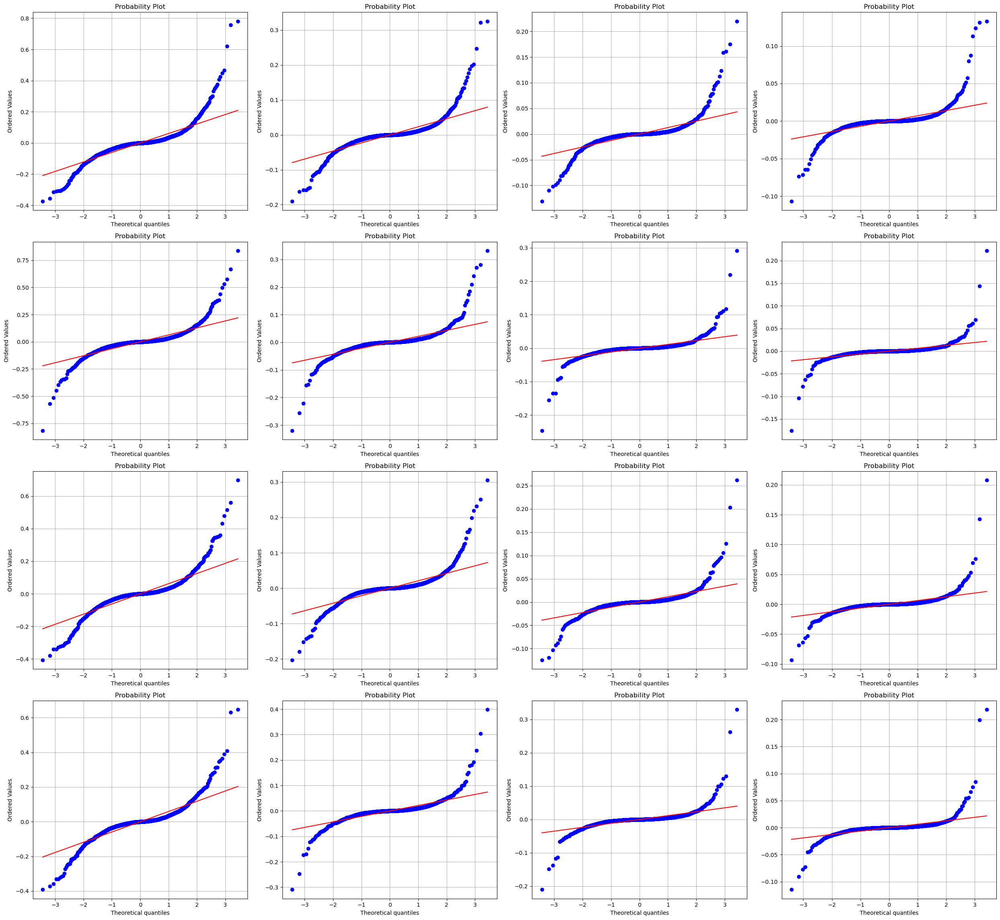

In [184]:
Vol_norm_qqPlot(Indices,symbols,False,'LogVol')

__From the QQPlot above, we can see that the log volatility of absolute return of indices does not obey normal distribution.__

### <span style="color:blue">(d) Repeat the same analysis for the volatility of major FX rates.</span>

### Realized Volatility

### <center>Realized Volatility Histogram of Main Currency Pairs<center>

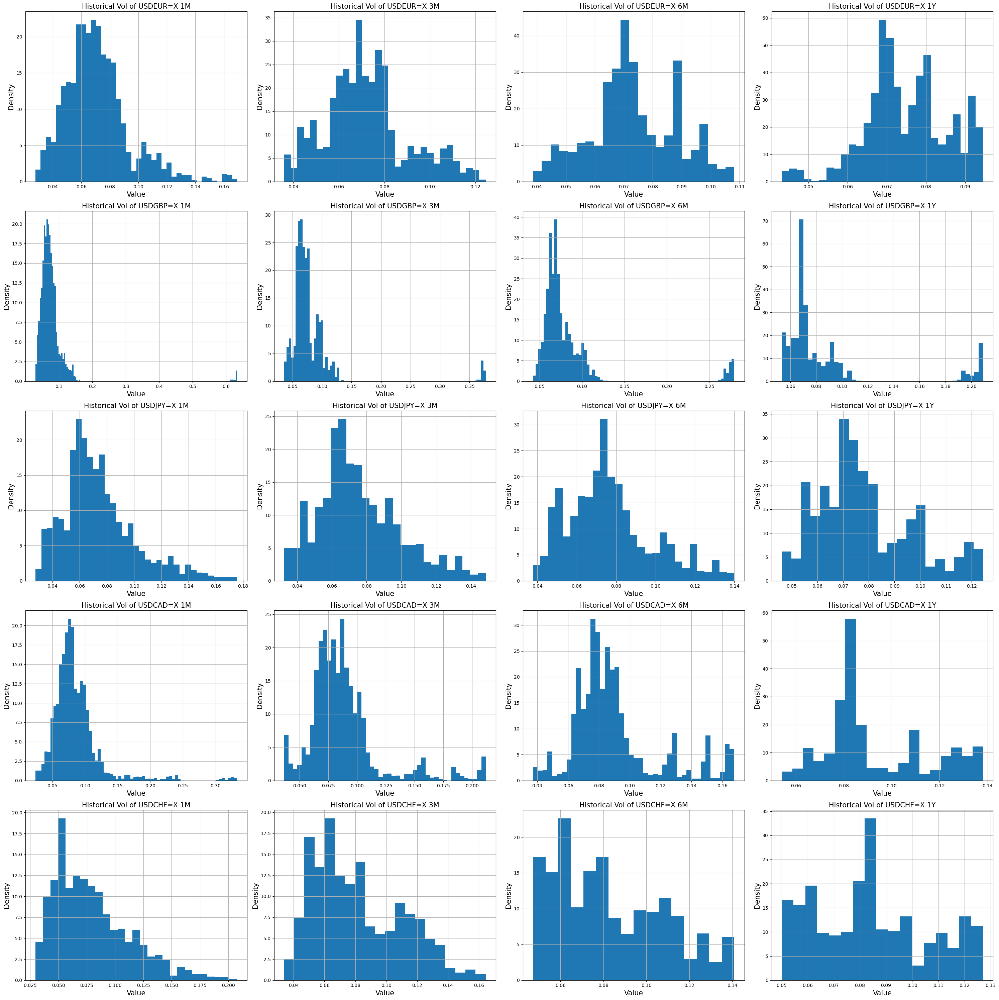

In [112]:
VolPlot(MCP,currency_pairs,False,'ReaVol')

### Realized Variance

### <center>Realized Variance Histogram of Main Currency Pairs<center>

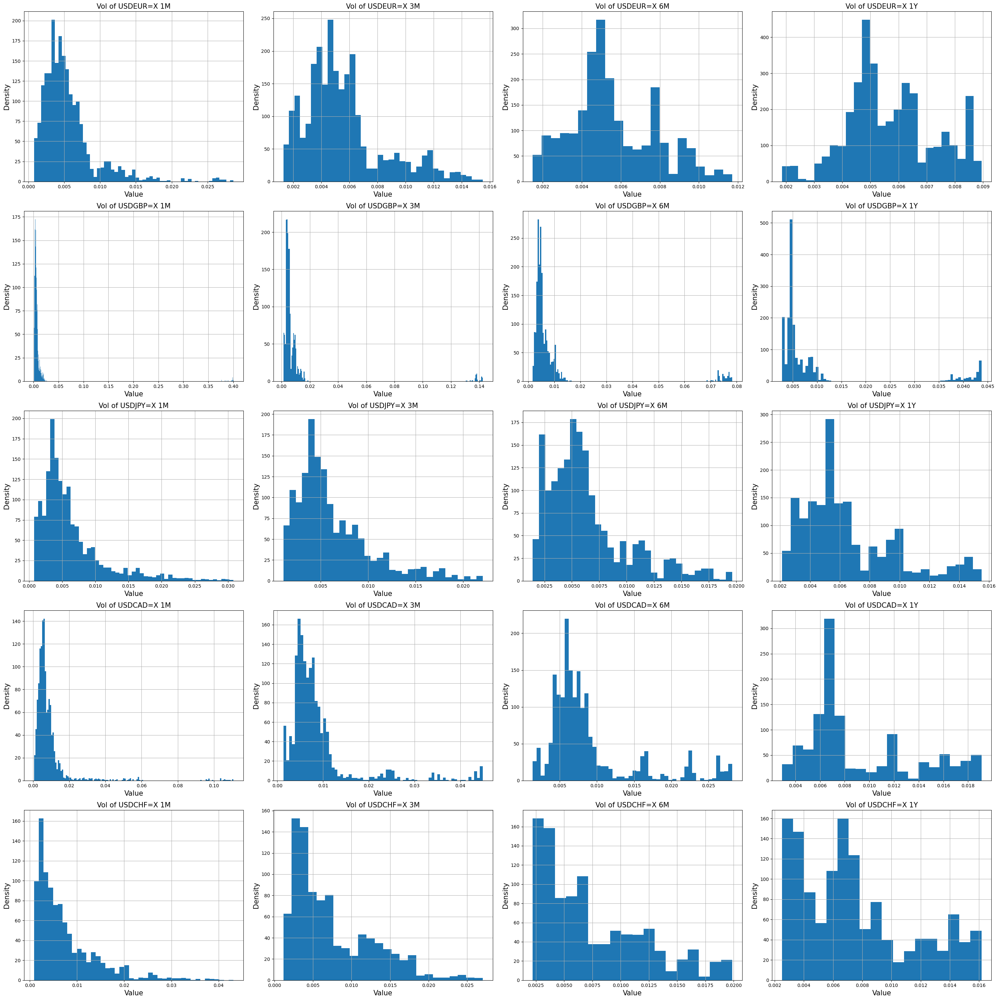

In [155]:
VolPlot(MCP,currency_pairs,False,'ReaVar')

### Log Volatilty of Absolute Return

### <center>Log Volatility Histogram of Main Currency Pairs<center>

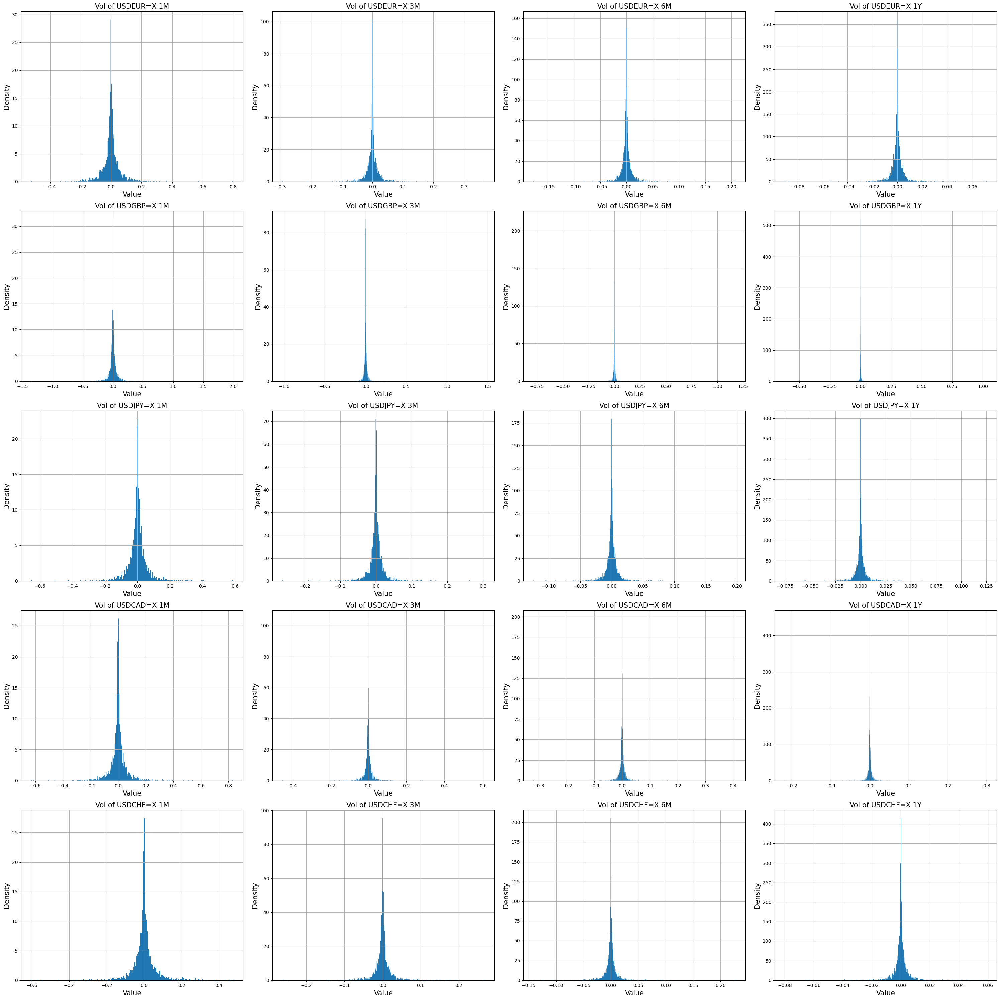

In [156]:
VolPlot(MCP,currency_pairs,False,'LogVol')

### <center>Log Volatility QQPlot of Main Currency Pairs<center>

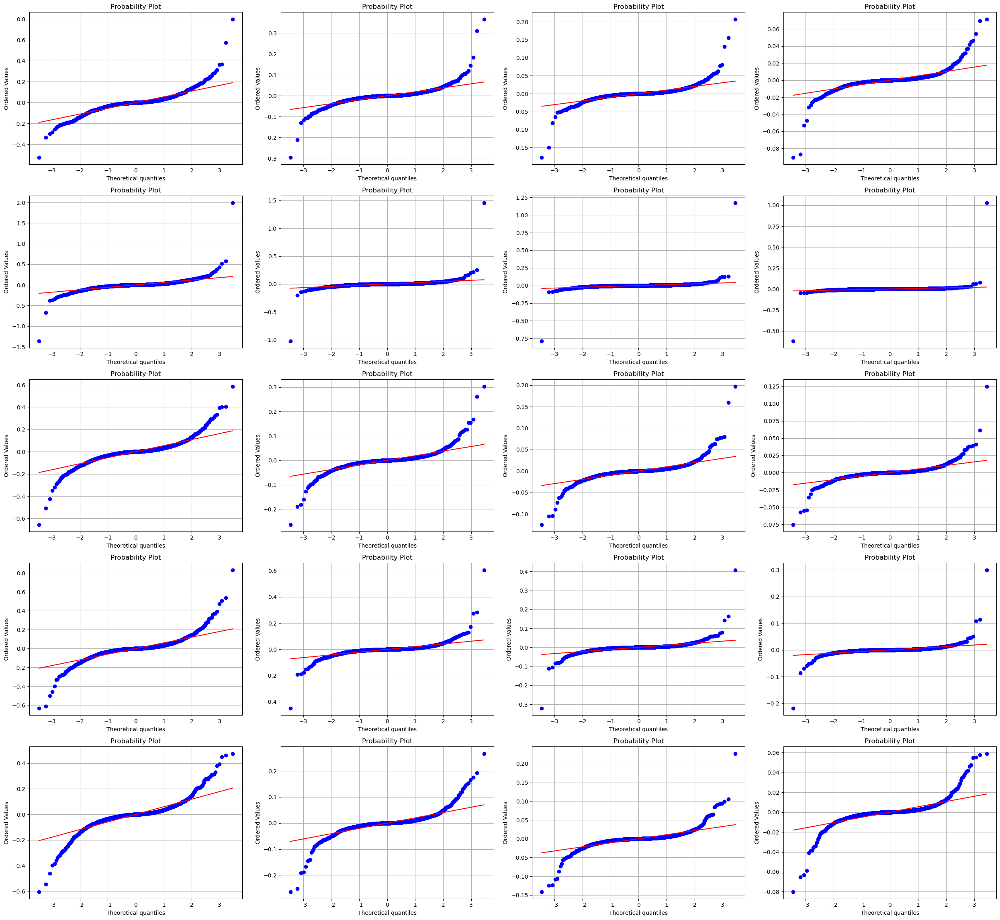

In [185]:
Vol_norm_qqPlot(MCP,currency_pairs,False,'LogVol')

__From the QQPlot above, we can see that the log volatility of absolute return of main currency pairs does not obey normal distribution.__

### <span style="color:blue">(e) Repeat the same analysis for major interest rates.</span>

### Realized Volatility

### <center>Realized Volatility Histogram of Interest Rates<center>

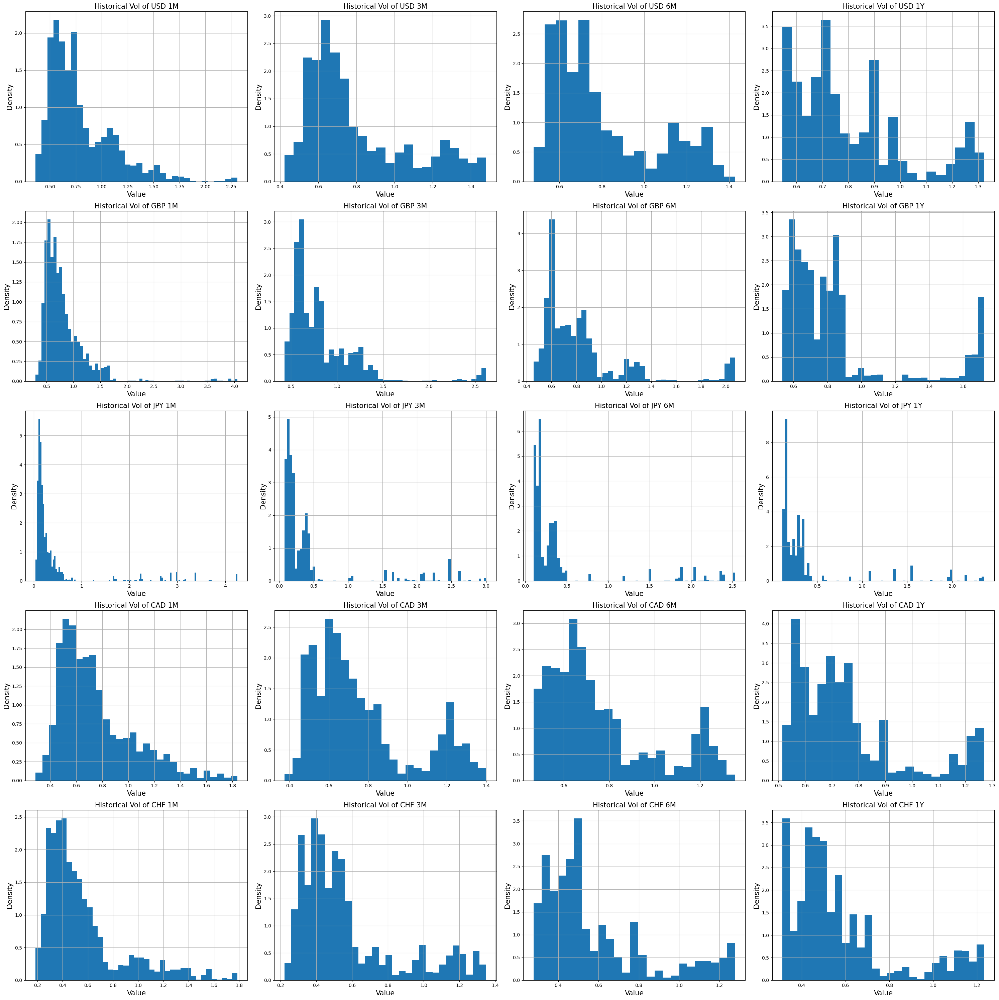

In [116]:
VolPlot(IR,IRs,True,ReaVol)

### Realized Variance

### <center>Realized Variance Histogram of Interest Rates<center>

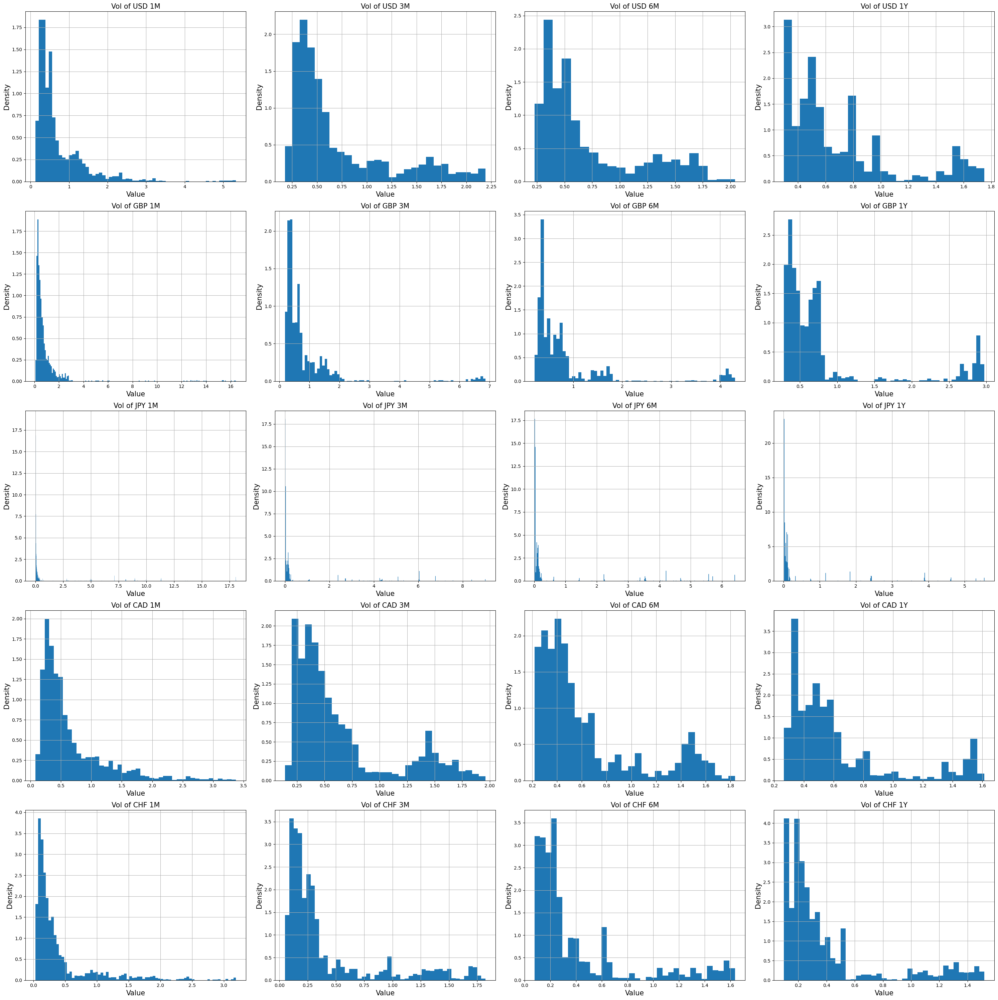

In [158]:
VolPlot(IR,IRs,True,'ReaVar')

### Log Volatilty of Absolute Return

### <center>Log Volatility Histogram of Interest Rates<center>

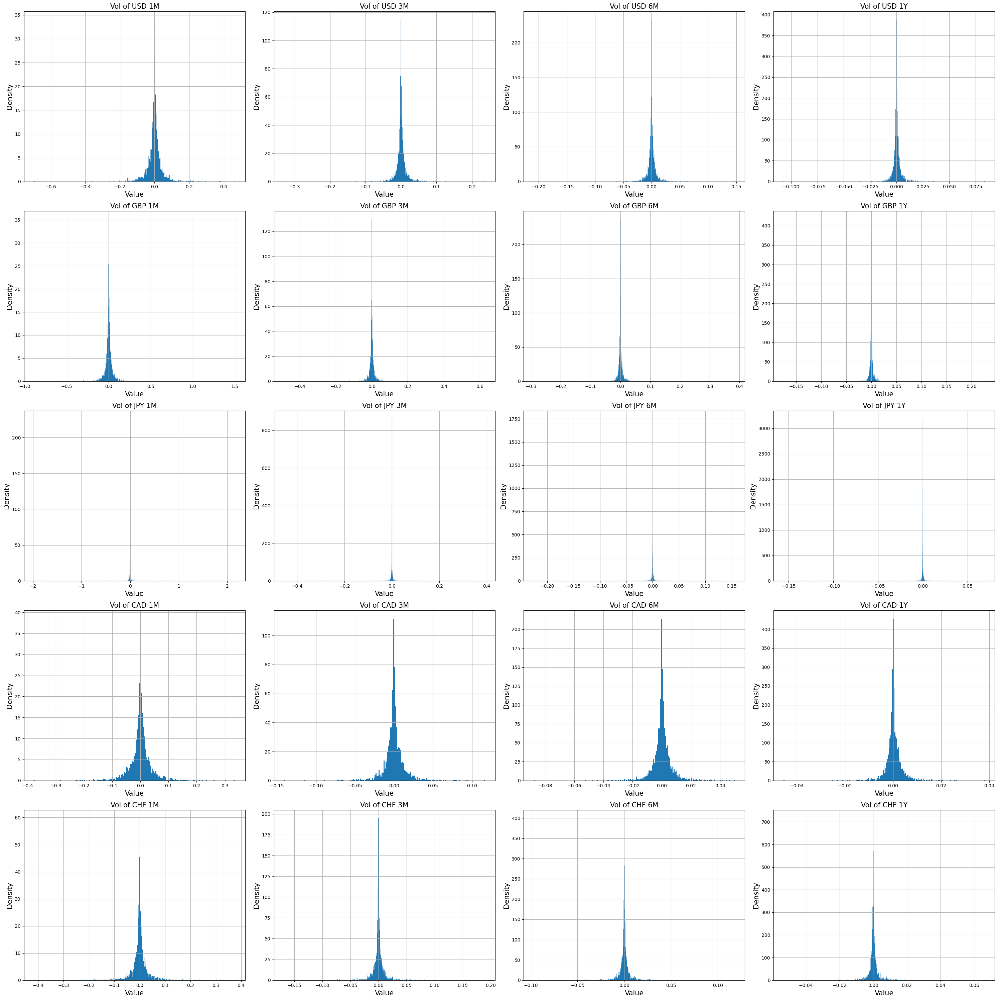

In [159]:
VolPlot(IR,IRs,True,'LogVol')

### <center>Log Volatility QQPlot of Interest Rates<center>

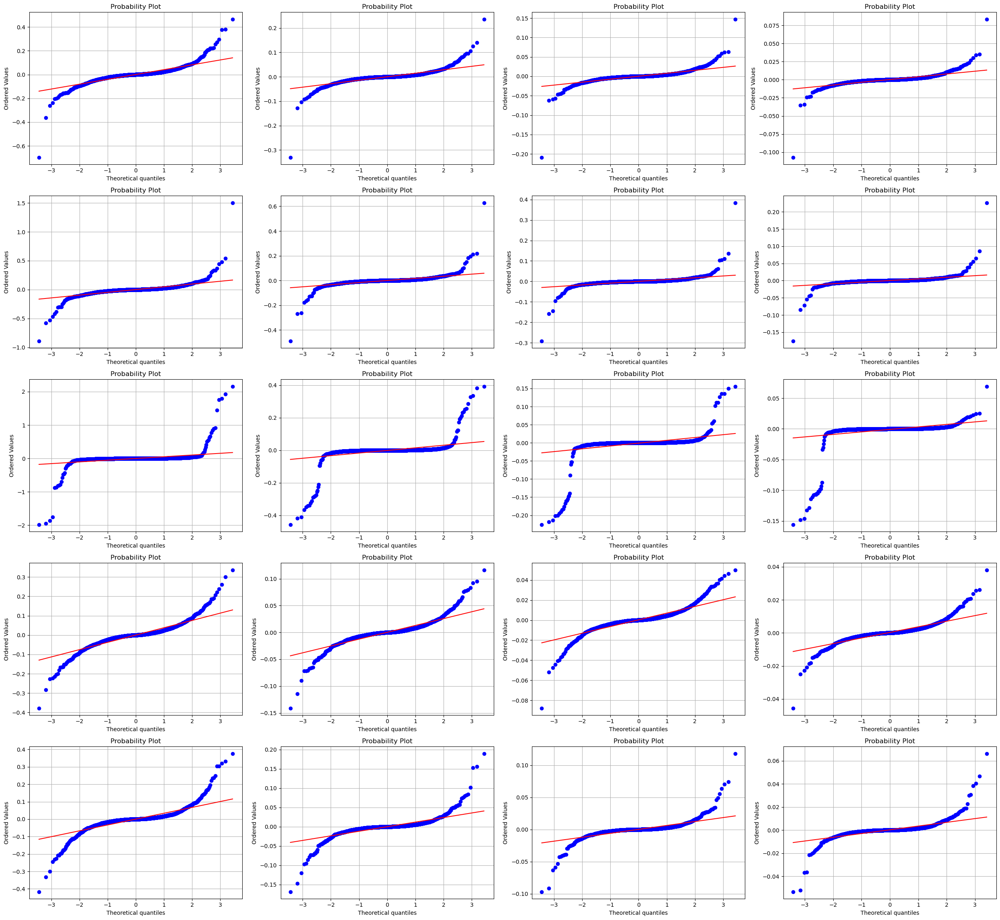

In [186]:
Vol_norm_qqPlot(IR,IRs,True,'LogVol')

__From the QQPlot above, we can see that the log volatility of absolute return of interest rates does not obey normal distribution.__

### <span style="color:blue">(f) Comment and conclude.</span>

__From the QQPlot, I can see that the log volatility does not obey Normal Distribution.__

__This accords with the fact which the histogram offers us: although the skewness is quite small (histogram tends to be symmetric), the peak is very high and the tail is thick (lots of outliers and extreme value on the tail), so the kurtosis is much higher than normal distribution.__

## <span style="color:blue"><center>6. Case of SPX and VIX (25 pts)</span><center>

### <span style="color:blue">We want to compare the VIX and the SPX and some estimation its realized volatility.</span>

### <span style="color:blue">(a) Compute time series of the SPX/VIX correlation. Is it expected?</span>

In [243]:
spx_data = yf.download('^GSPC', start='2013-12-01', end='2023-12-01')
vix_data = yf.download('^VIX', start='2013-11-30', end='2023-12-01')
SPX = pd.DataFrame(spx_data['Adj Close'].dropna())
VIX = pd.DataFrame(vix_data['Adj Close'].dropna())
SPX.rename(columns={'Adj Close':'SPX'}, inplace=True)
VIX.rename(columns={'Adj Close':'VIX'}, inplace=True)
SPVIX = pd.merge(Indices['^GSPC'], VIX, on='Date', how='inner')
SPVIX

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


,^GSPC,VIX
Date,,
2013-12-02,1800.900024,14.23
2013-12-03,1795.150024,14.55
2013-12-04,1792.810059,14.70
2013-12-05,1785.030029,15.08
2013-12-06,1805.089966,13.79
...,...,...
2023-11-24,4559.339844,12.46
2023-11-27,4550.430176,12.69
2023-11-28,4554.890137,12.69


In [206]:
corr_container = []

### 1M

In [207]:
SPVIX_1M_corr = SPVIX.rolling(window = _1M).corr(pairwise=True)
SPVIX_1M_corr = SPVIX_1M_corr.dropna()
corr_container.append(SPVIX_1M_corr)
SPVIX_1M_corr

^GSPC       VIX
Date                                
2014-01-07 ^GSPC  1.000000 -0.906062
           VIX   -0.906062  1.000000
2014-01-08 ^GSPC  1.000000 -0.915649
           VIX   -0.915649  1.000000
2014-01-09 ^GSPC  1.000000 -0.922030
...                    ...       ...
2023-11-28 VIX   -0.945953  1.000000
2023-11-29 ^GSPC  1.000000 -0.953875
           VIX   -0.953875  1.000000
2023-11-30 ^GSPC  1.000000 -0.947889
           VIX   -0.947889  1.000000

[4784 rows x 2 columns]

### 3M

In [208]:
SPVIX_3M_corr = SPVIX.rolling(window = _3M).corr(pairwise=True)
SPVIX_3M_corr = SPVIX_3M_corr.dropna()
corr_container.append(SPVIX_3M_corr)
SPVIX_3M_corr

^GSPC       VIX
Date                                
2014-03-10 ^GSPC  1.000000 -0.742120
           VIX   -0.742120  1.000000
2014-03-11 ^GSPC  1.000000 -0.732735
           VIX   -0.732735  1.000000
2014-03-12 ^GSPC  1.000000 -0.727973
...                    ...       ...
2023-11-28 VIX   -0.922324  1.000000
2023-11-29 ^GSPC  1.000000 -0.923480
           VIX   -0.923480  1.000000
2023-11-30 ^GSPC  1.000000 -0.923637
           VIX   -0.923637  1.000000

[4700 rows x 2 columns]

### 6M

In [209]:
SPVIX_6M_corr = SPVIX.rolling(window = _6M).corr(pairwise=True)
SPVIX_6M_corr = SPVIX_6M_corr.dropna()
corr_container.append(SPVIX_6M_corr)
SPVIX_6M_corr

^GSPC       VIX
Date                                
2014-06-16 ^GSPC  1.000000 -0.761800
           VIX   -0.761800  1.000000
2014-06-17 ^GSPC  1.000000 -0.766653
           VIX   -0.766653  1.000000
2014-06-18 ^GSPC  1.000000 -0.776454
...                    ...       ...
2023-11-28 VIX   -0.735680  1.000000
2023-11-29 ^GSPC  1.000000 -0.735731
           VIX   -0.735731  1.000000
2023-11-30 ^GSPC  1.000000 -0.737677
           VIX   -0.737677  1.000000

[4574 rows x 2 columns]

### 1Y

In [210]:
SPVIX_1Y_corr = SPVIX.rolling(window = _1Y).corr(pairwise=True)
SPVIX_1Y_corr = SPVIX_1Y_corr.dropna()
corr_container.append(SPVIX_1Y_corr)
SPVIX_1Y_corr

^GSPC       VIX
Date                                
2014-12-16 ^GSPC  1.000000 -0.303633
           VIX   -0.303633  1.000000
2014-12-17 ^GSPC  1.000000 -0.291684
           VIX   -0.291684  1.000000
2014-12-18 ^GSPC  1.000000 -0.282542
...                    ...       ...
2023-11-28 VIX   -0.890491  1.000000
2023-11-29 ^GSPC  1.000000 -0.891643
           VIX   -0.891643  1.000000
2023-11-30 ^GSPC  1.000000 -0.892524
           VIX   -0.892524  1.000000

[4322 rows x 2 columns]

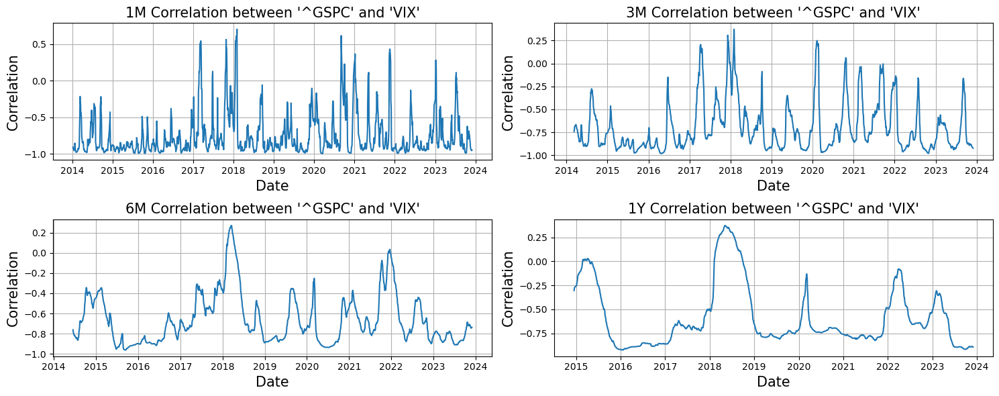

In [308]:
%matplotlib inline
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 6)) #, sharex=True, sharey=True

k = 0

for i in range(len(corr_container)):
    
    ax = axes[k//2,k%2]
    ax.set_title("{} Correlation between '^GSPC' and 'VIX'".format(rolling_tenors[i]), fontsize = 15)
    ax.set_xlabel("Date", fontsize = 15)
    ax.set_ylabel("Correlation", fontsize = 15)
    y = corr_container[i].loc[(slice(None), '^GSPC'), 'VIX']
    y.index = y.index.get_level_values(0)
    ax.plot(y)
    ax.grid(True)

    k += 1

plt.tight_layout()
plt.show()

__I think it is expected. As I learned from our Risk and Portfolio Management course, when the market is bad, investors increasingly buy puts. This would boost up the volatility, hence giving the market a momentum to turn up. So, there is a negative correlation between S&P500 and VIX.__

### <span style="color:blue">(b) Compare time series of the VIX to various estimator of the realized volatility of the S&P returns.</span>

### Method 1: Unweighted Historical Estimator

In [256]:
Arith_Return= SPX.pct_change()
Arith_Vol= Arith_Return.rolling(window=_1M).std()*(252**0.5)
Arith_Vol = Arith_Vol.dropna()
Arith_Vol.rename(columns={'SPX':'Arith_Vol'},inplace = True)
Arith_Vol

,Arith_Vol
Date,
2014-01-02,0.100527
2014-01-03,0.099568
2014-01-06,0.100002
2014-01-07,0.099621
2014-01-08,0.093068
...,...
2023-11-24,0.128855
2023-11-27,0.117510
2023-11-28,0.113335


### Method 2: EWMA Estimator

The idea of EWMA (Exponentially Weighed Moving Average) is that more recent data has more weight in estimation.

$$ p_{t} = \frac{2^{-h(t-1)}}{\sum_{s=0}^{T-1}2^{-hs}} = \frac{2^{-h(t-1)}(1-2^{-h})}{1-2^{-hT}} \approx 2^{-h(t-1)}(1-2^{-h}) \approx \frac{2^{-h(t-1)}hln(2)}{1+\frac{hln(2)}{2}}$$

In [261]:
EWMA_Vol = Arith_Return.ewm(span=_1M, adjust=False).std()*(252**0.5)
EWMA_Vol.rename(columns={'SPX':'EWMA_Vol'},inplace = True)
EWMA_Vol = EWMA_Vol.dropna()
EWMA_Vol

,EWMA_Vol
Date,
2013-12-04,0.021208
2013-12-05,0.018542
2013-12-06,0.102997
2013-12-09,0.091757
2013-12-10,0.082132
...,...
2023-11-24,0.120090
2023-11-27,0.116706
2023-11-28,0.111483


### Method 3: GARCH(1,1)

\begin{equation}
\sigma_t^2 = \omega + \alpha \varepsilon_{t-1}^2 + \beta \sigma_{t-1}^2
\end{equation}

$\sigma ^2$ represents the conditional variance at time $t$.

$\omega$ is a constant term representing the base volatility in the equation.

$\alpha$ is the coefficient of the autoregressive term for the squared residuals, indicating the impact of the squared residuals from the previous period on the current conditional variance.

$\epsilon_{t-1}^2$ represents the squared residuals at time $t-1$.

$\beta$ is the coefficient of the autoregressive term for the conditional variance, indicating the impact of the previous conditional variance on the current conditional variance.

$\sigma_{t-1}^2$represents the conditional variance at time $t-1$.

In [267]:
from arch import arch_model

model = arch_model(Arith_Return.dropna(), vol='Garch', p=1, q=1)
GARCH_Vol = model.fit(disp='off')
GARCH_Vol = GARCH_Vol.conditional_volatility*(252**0.5)
GARCH_Vol = pd.DataFrame(GARCH_Vol)
GARCH_Vol.rename(columns={'cond_vol':'GARCH_Vol'},inplace = True)
GARCH_Vol = GARCH_Vol.dropna()
GARCH_Vol

In [278]:
Estimators = pd.merge(Arith_Vol,VIX.div(100), on='Date', how='inner')
Estimators.rename(columns={'VIX':'VIX/100'},inplace = True)
Estimators = pd.merge(Estimators,EWMA_Vol, on='Date', how='inner')
Estimators = pd.merge(Estimators,GARCH_Vol, on='Date', how='inner')
Estimators

,Arith_Vol,VIX/100,EWMA_Vol,GARCH_Vol
Date,,,,
2014-01-02,0.100527,0.1423,0.094303,0.082982
2014-01-03,0.099568,0.1376,0.089802,0.103568
2014-01-06,0.100002,0.1355,0.086519,0.095198
2014-01-07,0.099621,0.1292,0.087119,0.090873
2014-01-08,0.093068,0.1287,0.083064,0.092002
...,...,...,...,...
2023-11-24,0.128855,0.1246,0.120090,0.109331
2023-11-27,0.117510,0.1269,0.116706,0.099775
2023-11-28,0.113335,0.1269,0.111483,0.093713


In [288]:
estimators_list = list(Estimators.columns)
estimators_list

['Arith_Vol', 'VIX/100', 'EWMA_Vol', 'GARCH_Vol']

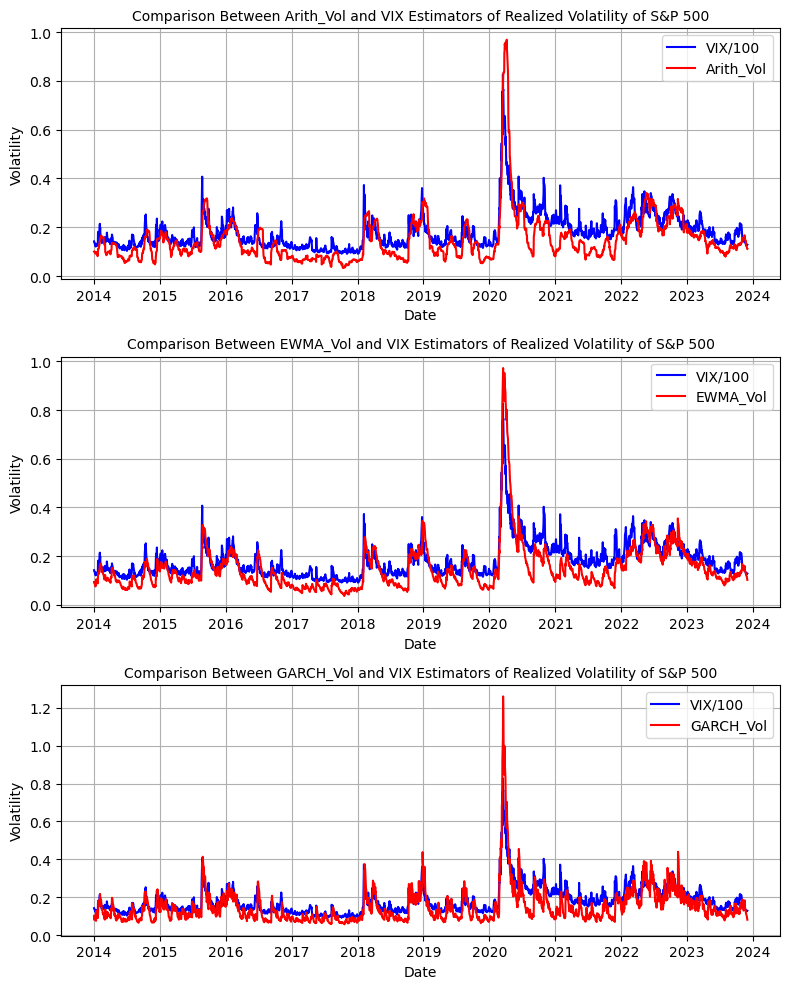

In [296]:
%matplotlib inline
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(8, 10)) #, sharex=True, sharey=True

k = 0

for i in [0,2,3]:
    
    ax = axes[k]
    estimator = estimators_list[i]
    ax.set_title("Comparison Between {} and VIX Estimators of Realized Volatility of S&P 500".format(estimator), fontsize = 10)
    ax.set_xlabel("Date", fontsize = 10)
    ax.set_ylabel("Volatility", fontsize = 10)
    ax.plot(Estimators['VIX/100'], label='VIX/100', color='blue')
    ax.plot(Estimators[estimator], label="{}".format(estimator), color='red')
    ax.legend()
    ax.grid(True)

    k += 1

plt.tight_layout()
plt.show()

__We can see that VIX offers a similar trending with other estimators, but different values. It is more closer to the GARCH Volatility.__

### <span style="color:blue">(c) Is the VIX a good predictor the future realized volatility? For instance, draw scatter plots of VIX at a date $t$ compared to various estimator of the realized volatility at date $t + 1M$</span>

### VIX/100, EWMA_Vol, GARCH_Vol respectively compared with 1M Lag Actual Realized Volatility of S&P 500

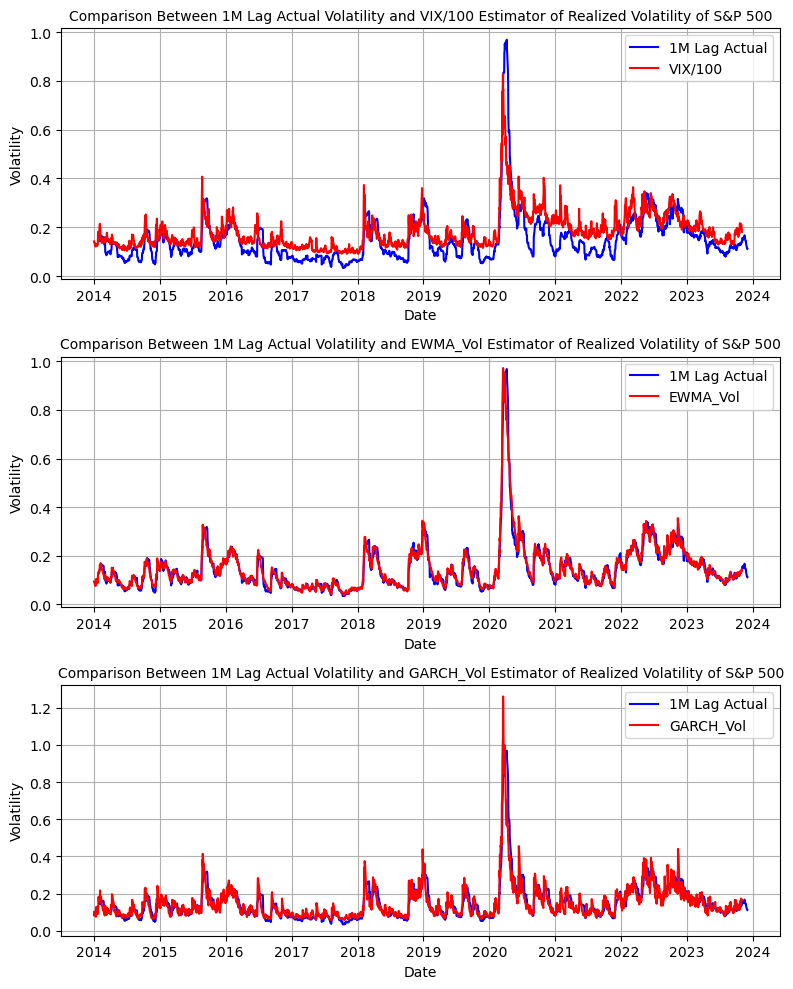

In [297]:
%matplotlib inline
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(8, 10)) #, sharex=True, sharey=True

for i in [1,2,3]:
    
    ax = axes[i-1]
    estimator = estimators_list[i]
    ax.set_title("Comparison Between 1M Lag Actual Volatility and {} Estimator of Realized Volatility of S&P 500".format(estimator), fontsize = 10)
    ax.set_xlabel("Date", fontsize = 10)
    ax.set_ylabel("Volatility", fontsize = 10)
    ax.plot(Estimators["Arith_Vol"][_1M:], label='1M Lag Actual', color='blue')
    ax.plot(Estimators[estimator][:-_1M], label="{}".format(estimator), color='red')
   
    ax.legend()
    ax.grid(True)

plt.tight_layout()
plt.show()

### Scatter plots of VIX at a date $t$ compared to various estimators of the realized volatility at date $t + 1M$

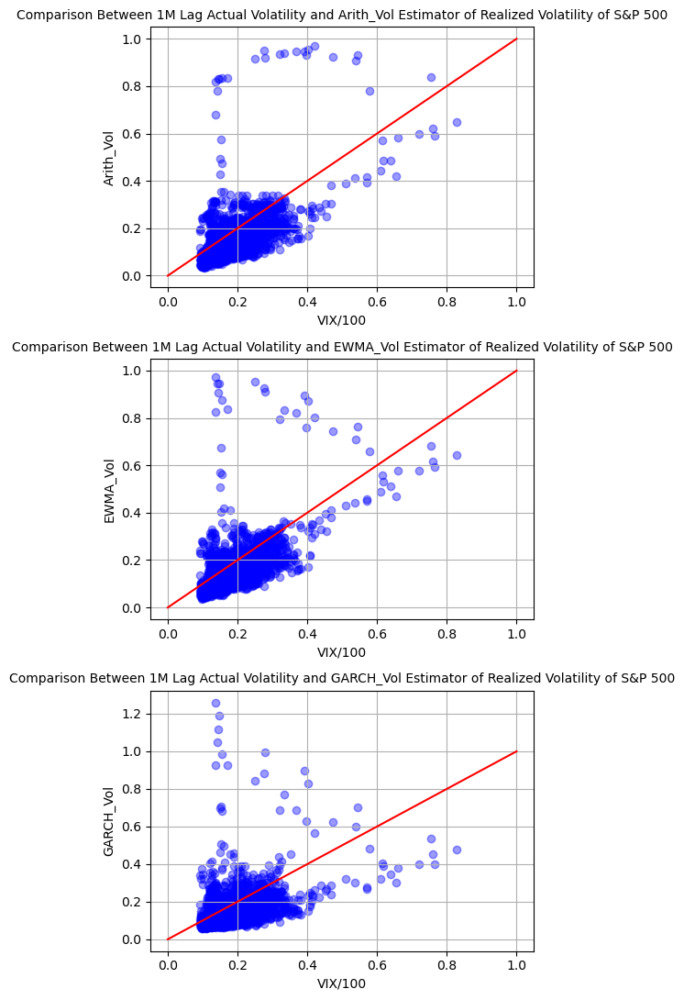

In [307]:
%matplotlib inline
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(5, 11)) #, sharex=True, sharey=True

k =0

for i in [0,2,3]:
    
    ax = axes[k]
    estimator = estimators_list[i]
    ax.set_title("Comparison Between 1M Lag Actual Volatility and {} Estimator of Realized Volatility of S&P 500".format(estimator), fontsize = 10)
    ax.set_xlabel("VIX/100", fontsize = 10)
    ax.set_ylabel("{}".format(estimator), fontsize = 10)
    ax.scatter(Estimators['VIX/100'][:-_1M], Estimators[estimator][_1M:], color='blue', alpha = 0.4)
    x = np.linspace(0, 1, 100)
    ax.plot(x, x, color = 'red')
    ax.grid(True)
    
    k += 1

plt.tight_layout()
plt.show()

#### <span style="color:blue"></span>

__We are see that VIX is not such a good estimator. Both EWMA_Vol and GARCH_Vol perform better than VIX in predicting the future realized volatility of S&P 500.__